# Chap 3 Ranodm Variable and Distribution

## 3-2 离散型随机变量分布列

从事件到变量，再到离散分布列

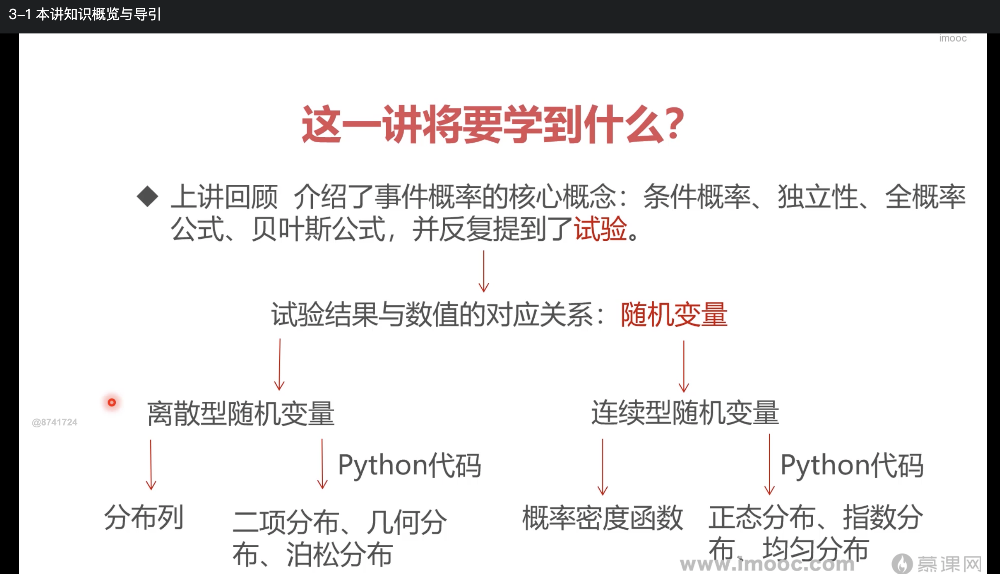

In [ ]:
## 题目大纲
from IPython.display import Image, display
display(Image('/content/screen1.png', width=500, height=300))
# display(Image('2.png'))

事件是某件具体的事情(A, B1.....Bn)，是结果

每次实验都有可能发生不同的事件B，这里每个B是具体的事件,即试验结果

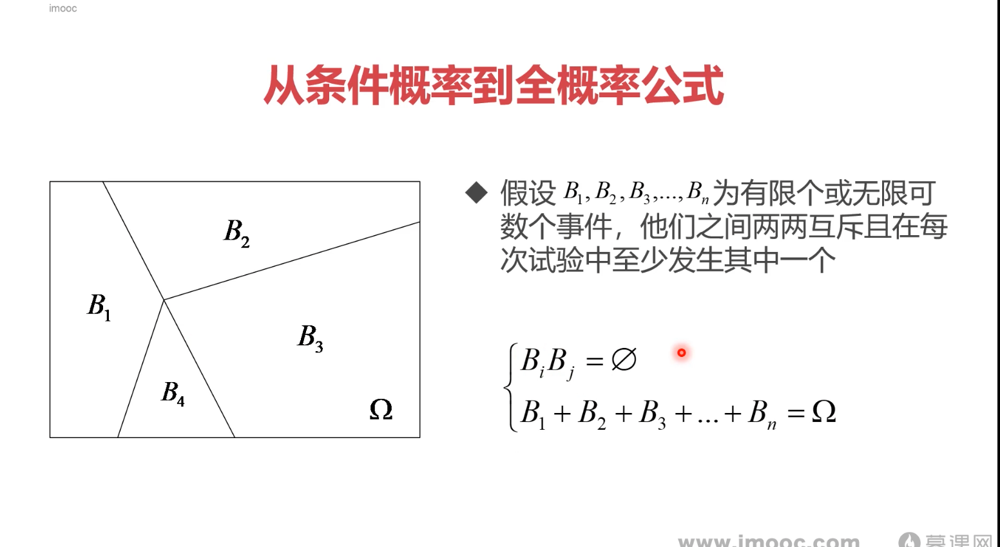

In [ ]:
from IPython.display import Image, display
display(Image('/content/screen2.png', width=500, height=300))

将每次试验所有可能出现的结果附上对应的数值

随机变量指的是：实验结果(试验具体事件)与数值的对应关系

上图中B1......Bn看成1个随机变量，B = B1则为具体取值，是某个具体事件

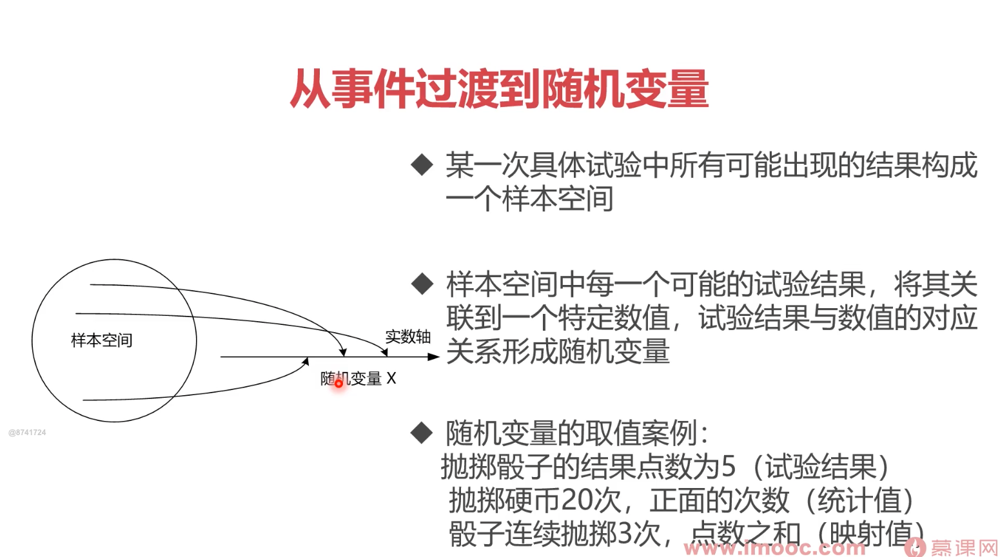

In [ ]:
from IPython.display import Image, display
display(Image('/content/screen3.png', width=500, height=300))

我们在意随机变量的取值

一次试验中每个取值出现的概率

随机变量的统计特征和度量方法

下图中Px(x)是某个取值的概率

P({X = x}) 是某个具体事件的概率

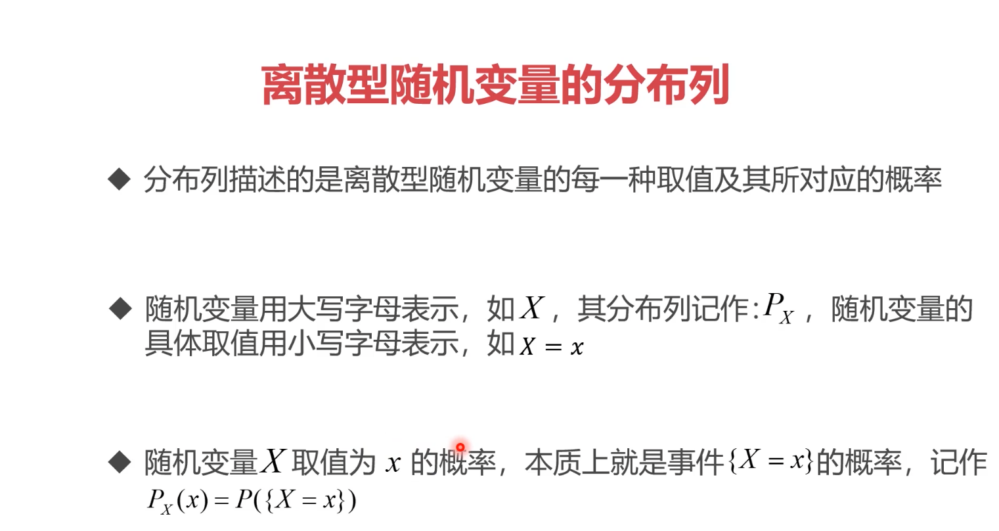

In [ ]:
from IPython.display import Image, display
display(Image('/content/screen4.png', width=500, height=300))

下图中S则是一系列可能发生事件的集合，比如 X > 0

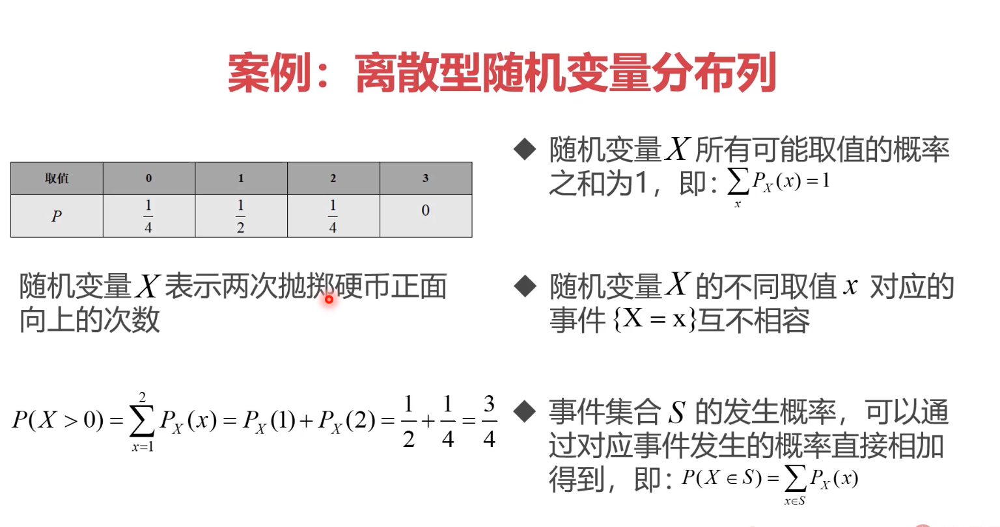

In [ ]:
from IPython.display import Image, display
display(Image('/content/screen5.png', width=500, height=300))

### 3-3/3-4 二项分布pmf函数

横坐标：出现正面硬币的次数，最多可以是10次

不同k对应不同n，p时的概率

这里的一次试验为投硬币n次，event是硬币正面出现次数

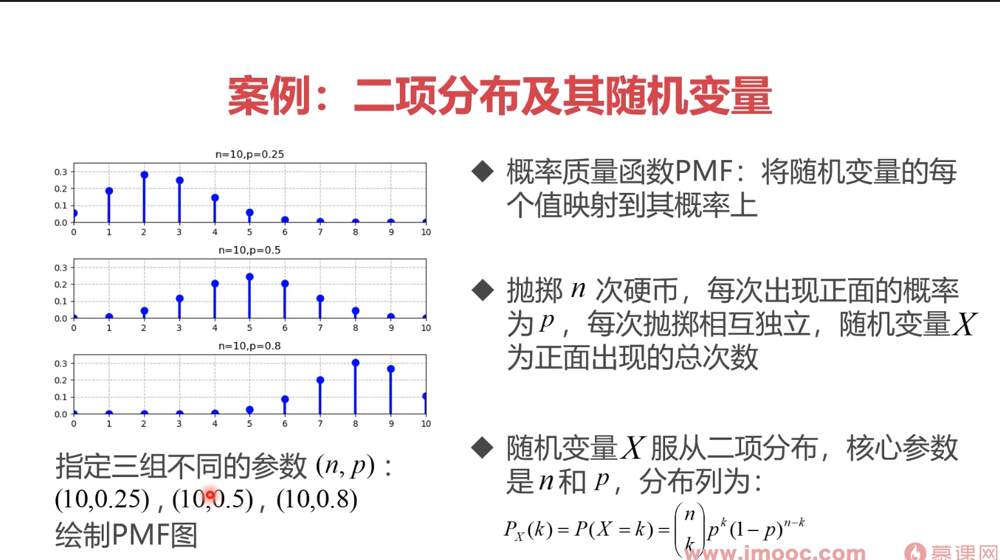

In [ ]:
from IPython.display import Image, display
display(Image('/content/screen6.png', width=500, height=300))

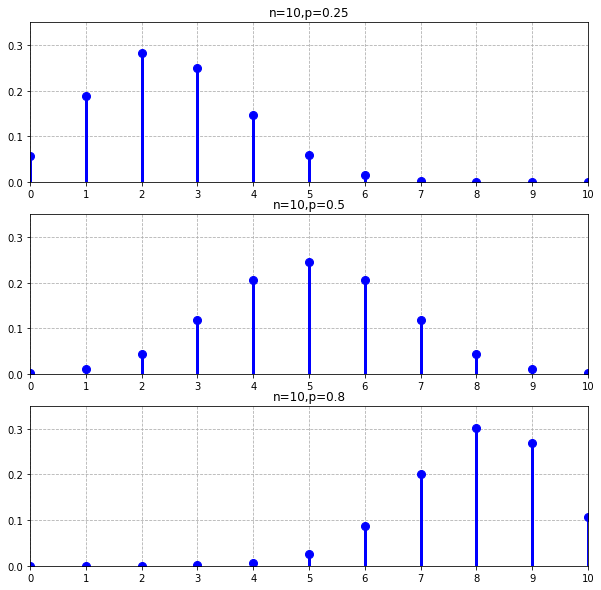

In [ ]:
# 绘制出来概率的图
from scipy.stats import binom
import matplotlib.pyplot as plt

fig, ax = plt.subplots(3,1,figsize=(10, 10))
params = [(10,0.25),(10,0.5),(10,0.8)]
x = range(11)

for i in range(len(params)):
  binom_rv = binom(n=params[i][0], p = params[i][1])
  ax[i].set_title('n={},p={}'.format(params[i][0],params[i][1]))
  ax[i].plot(x, binom_rv.pmf(x),'bo',ms=8) # 蓝色圆形，大小为8 mark size
  ax[i].vlines(x, 0, binom_rv.pmf(x), colors='b',lw=3) #线宽3
  ax[i].set_xlim(0,10)
  ax[i].set_ylim(0,0.35)
  ax[i].set_xticks(x) # 设置横纵坐标刻度
  ax[i].set_yticks([0,0.1,0.2,0.3,])
  ax[i].grid(ls='--')

plt.show()

二项式分布随机变量数字特征

期望：E[X] = np

方差：V[x] = np(1-p)

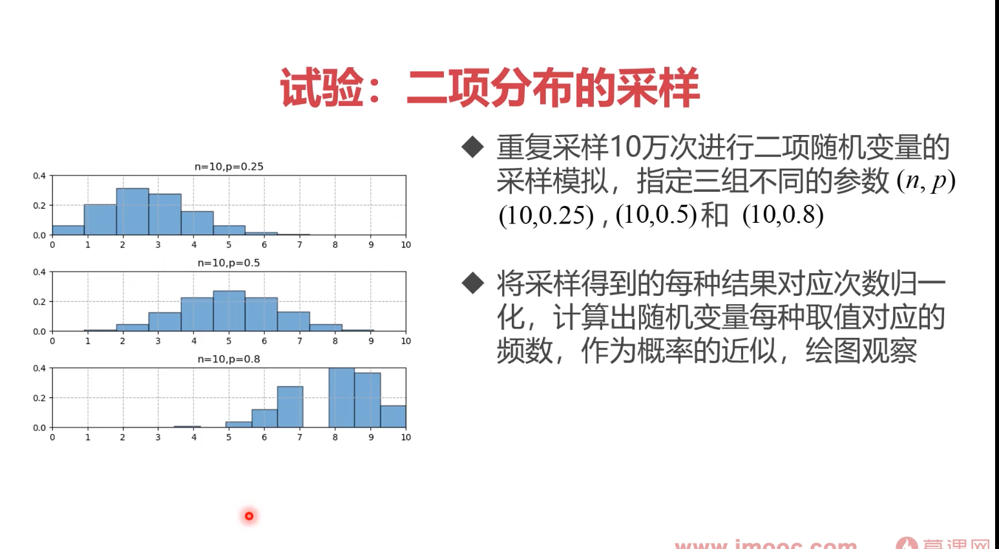

In [ ]:
from IPython.display import Image, display
display(Image('/content/screen7.png', width=500, height=300))

rvs0:[4 2 3 ... 2 1 0]
rvs1:[4 5 1 ... 4 6 6]
rvs2:[ 8  6  9 ...  9  9 10]


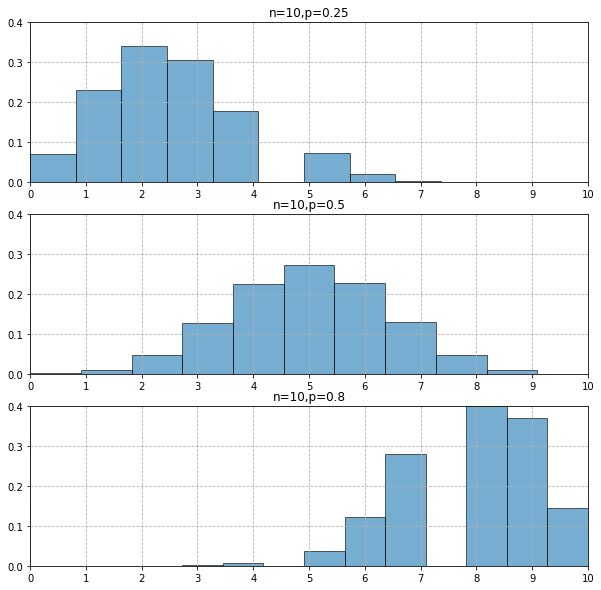

In [ ]:
# 模拟采样10万次绘图
from scipy.stats import binom
import matplotlib.pyplot as plt

fig, ax = plt.subplots(3,1,figsize=(10, 10))
params = [(10,0.25),(10,0.5),(10,0.8)]
x = range(11)

for i in range(len(params)):
  binom_rv = binom(n=params[i][0], p = params[i][1]) #随机变量
  rvs= binom_rv.rvs(size=100000) #得到个10万的数组，对应试验次数，每个数代表：一次试验正面出现几次
  ax[i].hist(rvs, bins=11, density=True, #11个条形,density就是归一化，就是硬币正面出现5次占100000次里面百分之几
             alpha=0.6, # 透明度
             edgecolor='k')  #每个条形柱子边框


  ax[i].set_title('n={},p={}'.format(params[i][0],params[i][1]))
  ax[i].set_xlim(0,10)
  ax[i].set_ylim(0,0.4)
  ax[i].set_xticks(x) # 设置横纵坐标刻度
  ax[i].grid(ls='--')
  print('rvs{}:{}'.format(i,rvs)) 

plt.show()


In [ ]:
# 求出方差和期望
from scipy.stats import binom
import matplotlib.pyplot as plt
import numpy as np

binom_rv= binom(n=10,p=0.25)
mean, var, skew, kurt = binom_rv.stats(moments='mvsk') #直接用函数返回 mean，var

rvs= binom_rv.rvs(size=100000)
E_sam = np.mean(rvs)
S_sam = np.std(rvs)
V_sam = S_sam * S_sam

print('mean={},var={}\n'.format(mean,var))
print('E_sam={},V_sam={}\n'.format(E_sam,V_sam))
print('E=np={},V=np(1-p)={}'.format(10*0.25, 10*0.25*0.75))

mean=2.5,var=1.875

E_sam=2.50087,V_sam=1.8819192431

E=np=2.5,V=np(1-p)=1.875


### 3-5 几何分布的性质与采样

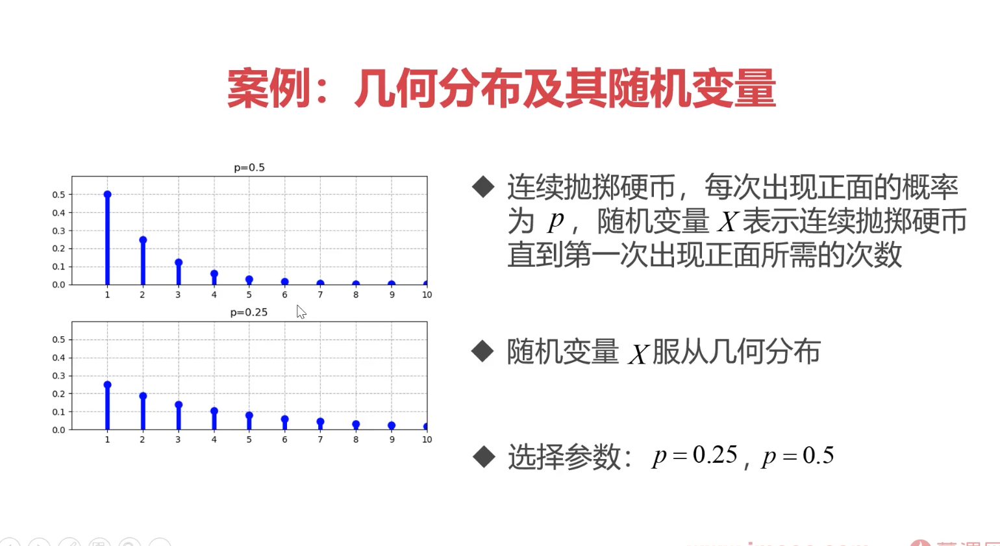

In [ ]:
from IPython.display import Image, display
display(Image('/content/screen8.png',width=500,height=300))

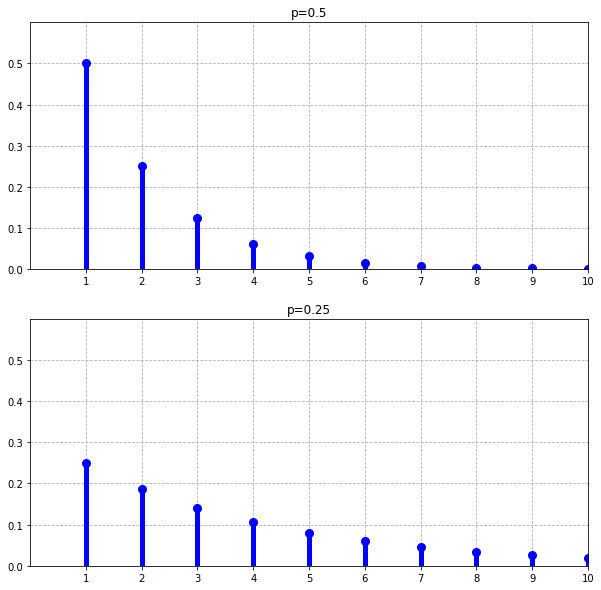

In [ ]:
from scipy.stats import geom
import matplotlib.pyplot as plt

fix, ax = plt.subplots(2,1,figsize=(10,10))
params = [0.5,0.25] # p
x = range(1,11) #事件结果，至少抛多少次硬币能看到正面，至少1次

for i in range(len(params)):
  geom_rv = geom(p=params[i])
  ax[i].set_title('p={}'.format(params[i]))
  ax[i].plot(x, geom_rv.pmf(x), 'bo', ms=8)
  ax[i].vlines(x,0,geom_rv.pmf(x),colors='b',lw=5)
  ax[i].set_xlim(0,10)
  ax[i].set_ylim(0,0.6)
  ax[i].set_xticks(x)
  ax[i].set_yticks([0,0.1,0.2,0.3,0.4,0.5])
  ax[i].grid(ls='--')

plt.show()

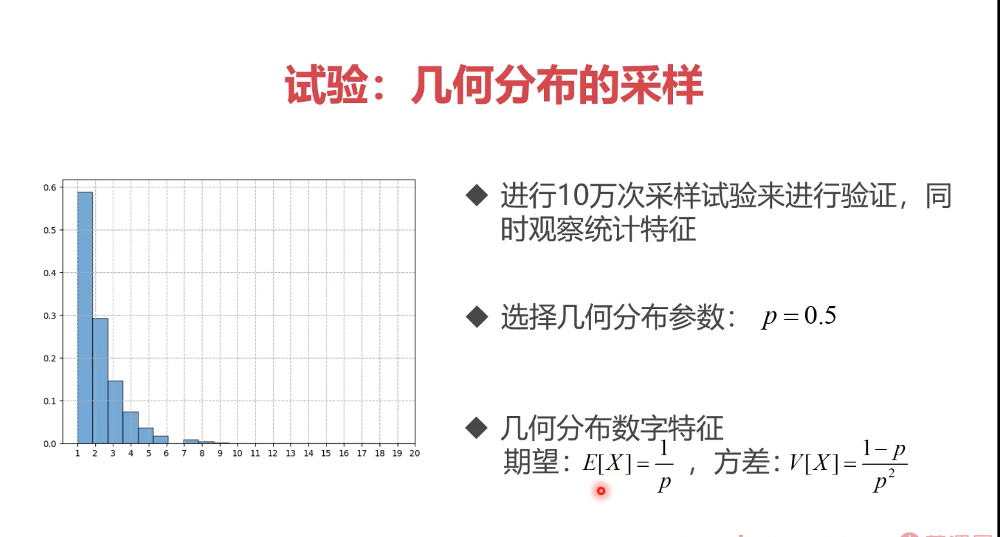

In [ ]:
from IPython.display import Image, display
display(Image('/content/screen9.png',width=500,height=300))

mean=2.0,var=2.0


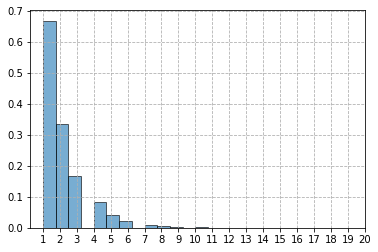

In [ ]:
from scipy.stats import geom
import matplotlib.pyplot as plt

x = range(1,21)
geom_rv = geom(p=0.5)
geom_rvs = geom_rv.rvs(size=100000)
plt.hist(geom_rvs, bins=20,density=True,alpha=0.6,edgecolor='k')
plt.gca().axes.set_xticks(x)
plt.grid(ls='--')

mean, var, sekw, kurt = geom_rv.stats(moments='mvsk')
print('mean={},var={}'.format(mean,var))

plt.show()

### 3-6 possion 柏松分布

possion 就是n非常大但是p非常小的时候的二项式分布的近似分布

相对于n很大但p很小时的二项式分布，possion优势为计算简单

lambda：average number of events on the interval

n：total possible events on the interval

p：probability of the event happen

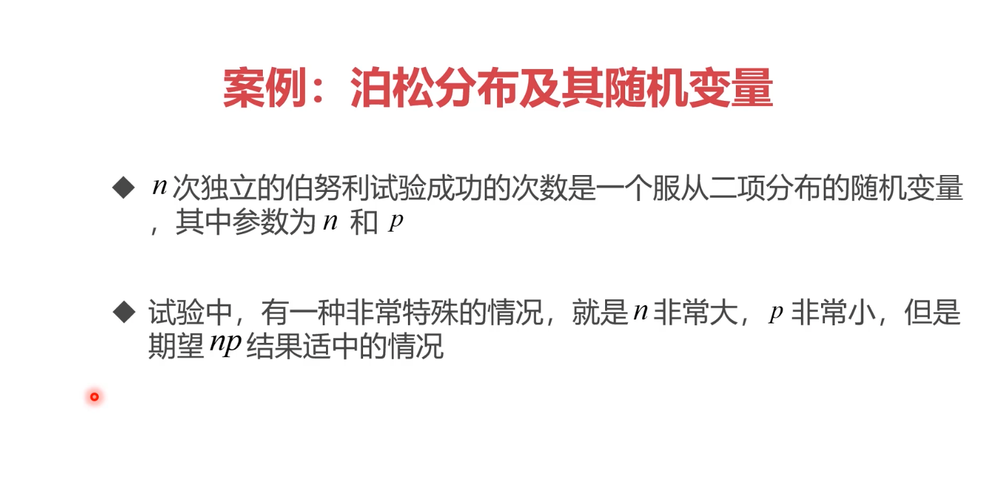

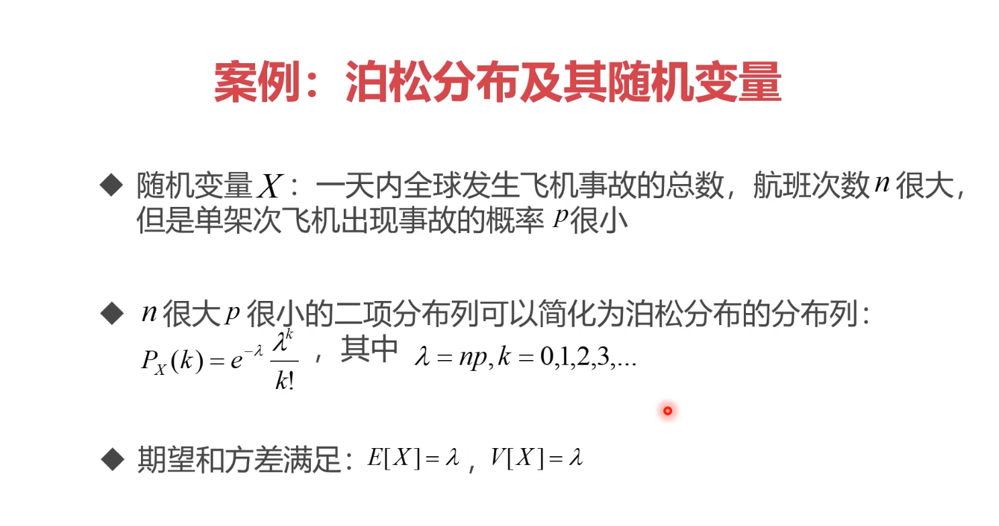

In [ ]:
from IPython.display import Image, display
display(Image('/content/screen10.png',width=500,height=300))
display(Image('/content/screen11.png',width=500,height=300))

mean=1.99948
var=1.9884797295999996


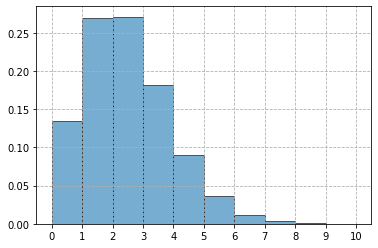

In [ ]:
# lamda = 2 的possion分布
import numpy as np
from scipy.stats import poisson
import matplotlib.pyplot as plt

lambda_ = 2
data = poisson.rvs(mu=lambda_, size=100000)
plt.figure()
plt.hist(data, density=True, alpha=0.6, edgecolor='k')
plt.gca().axes.set_xticks(range(0,11))
print('mean={}'.format(np.mean(data)))
print('var={}'.format(np.square(np.std(data))))
plt.grid(ls='--')

plt.show()

## 3-7 连续型随机变量

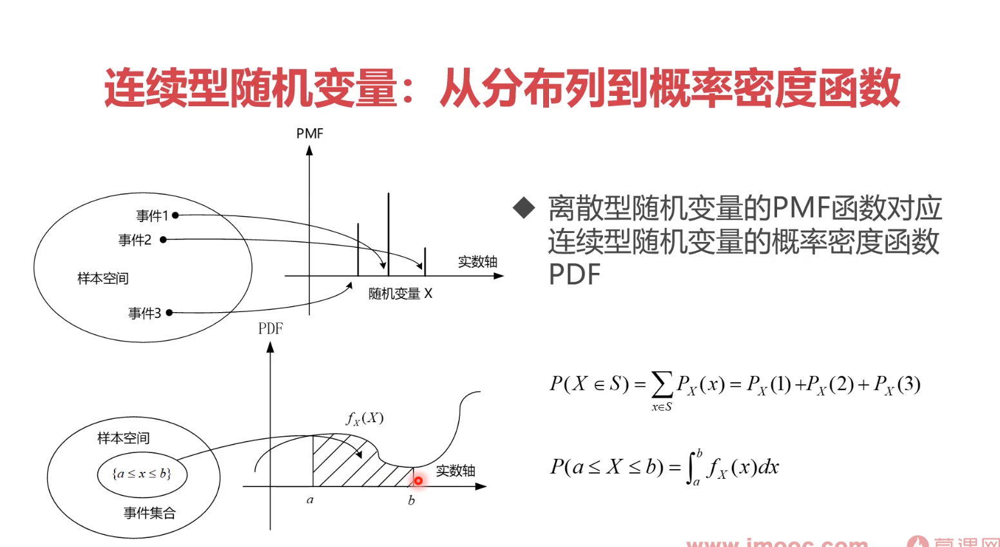

In [ ]:
from IPython.display import Image, display
display(Image('/content/screen12.png',width=500,height=300))

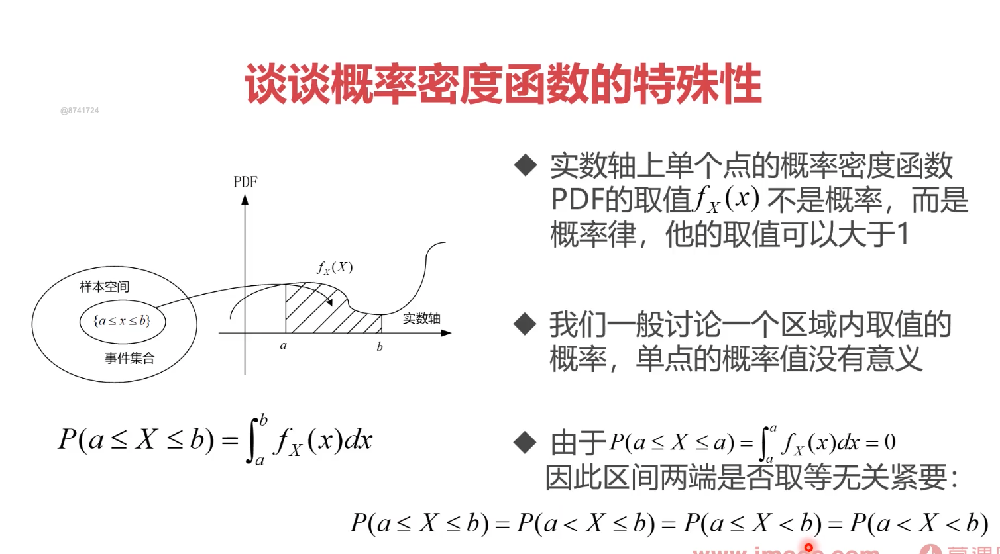

In [ ]:
from IPython.display import Image, display
display(Image('/content/screen13.png',width=500,height=300))

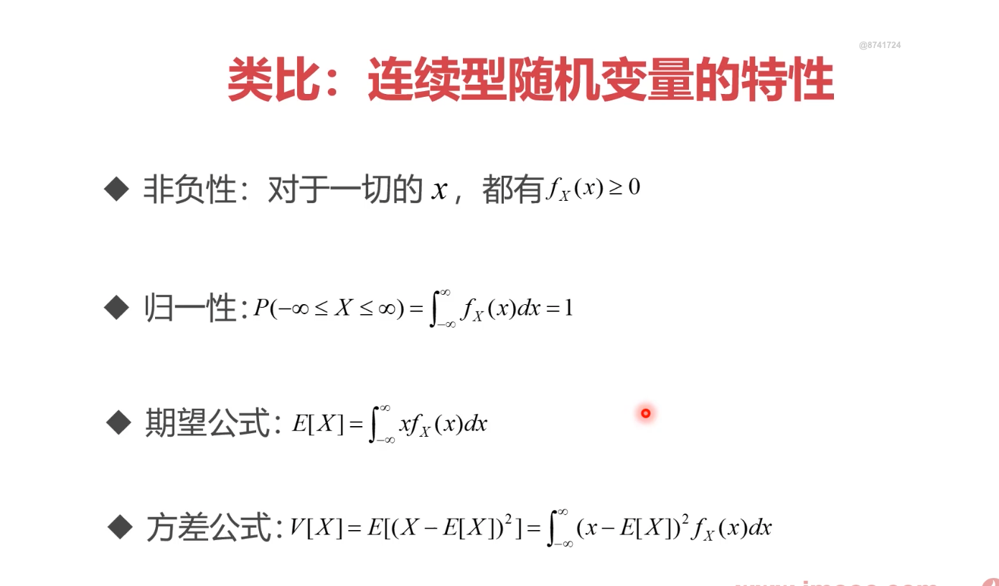

In [ ]:
from IPython.display import Image, display
display(Image('/content/screen14.png',width=500,height=300))

### 3-8 normal distribution

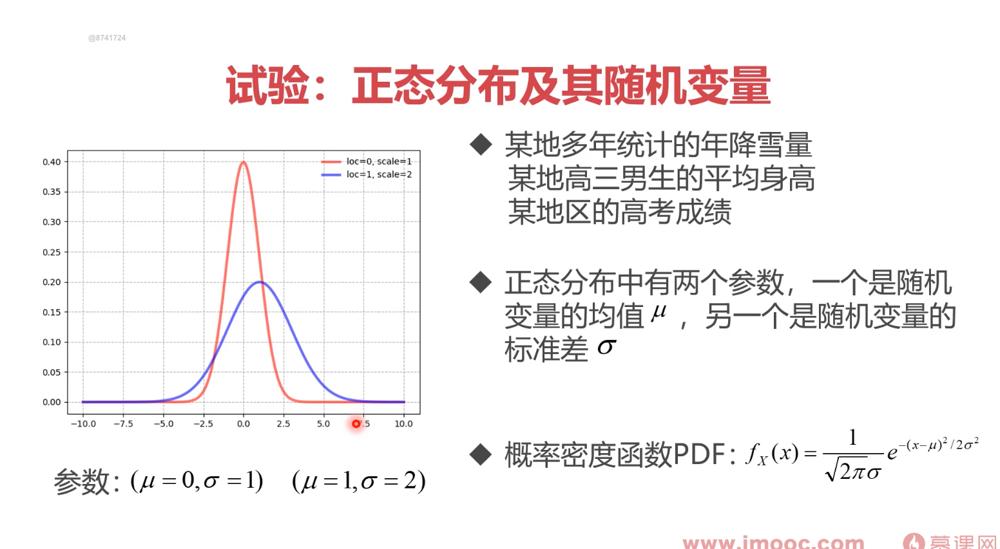

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen15.png',width=500,height=300))

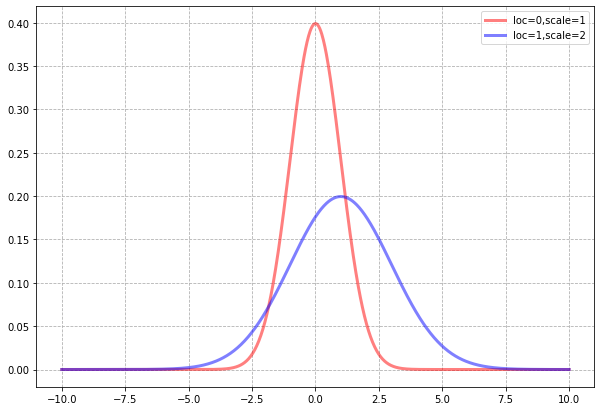

In [ ]:
from scipy.stats import norm
import matplotlib.pyplot as plt
import numpy as np

fix,ax = plt.subplots(1,1,figsize=(10,7))
norm_0 = norm(loc=0,scale=1) # loc= mu, scale = std
norm_1= norm(loc=1,scale=2)

x = np.linspace(-10,10,1000) # 1000个离散点,近似一条曲线
ax.plot(x, norm_0.pdf(x),color='red',lw=3, alpha=0.5, label='loc=0,scale=1')
ax.plot(x, norm_1.pdf(x),color='blue',lw=3, alpha=0.5, label='loc=1,scale=2')

ax.legend(loc='best')
plt.grid(ls='--')

plt.show()

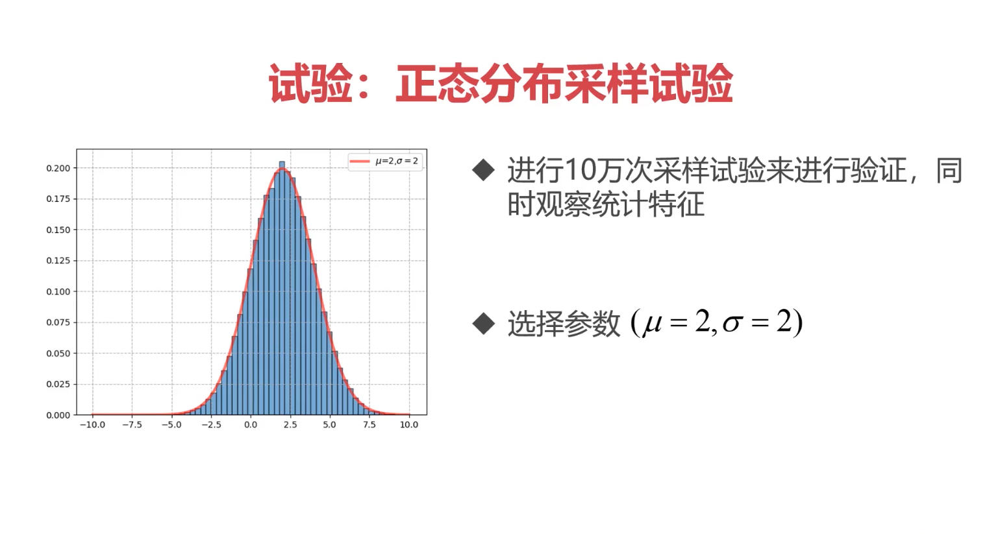

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen16.png',width=500,height=300))

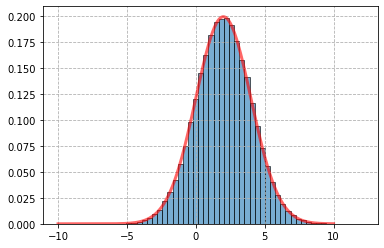

In [ ]:
from scipy.stats import norm
import matplotlib.pyplot as plt
import numpy as np

norm_rv = norm(loc=2, scale=2)
norm_rvs = norm_rv.rvs(size=100000)

x = np.linspace(-10,10,1000)
plt.plot(x, norm_rv.pdf(x),'r',lw=3,alpha=0.6)
plt.hist(norm_rvs,density=True,bins=50,alpha=0.6,edgecolor='k')
plt.grid(ls='--')
plt.show()

### 3-9 指数分布

一台机器剩下的寿命越久，概率越小，可能性小

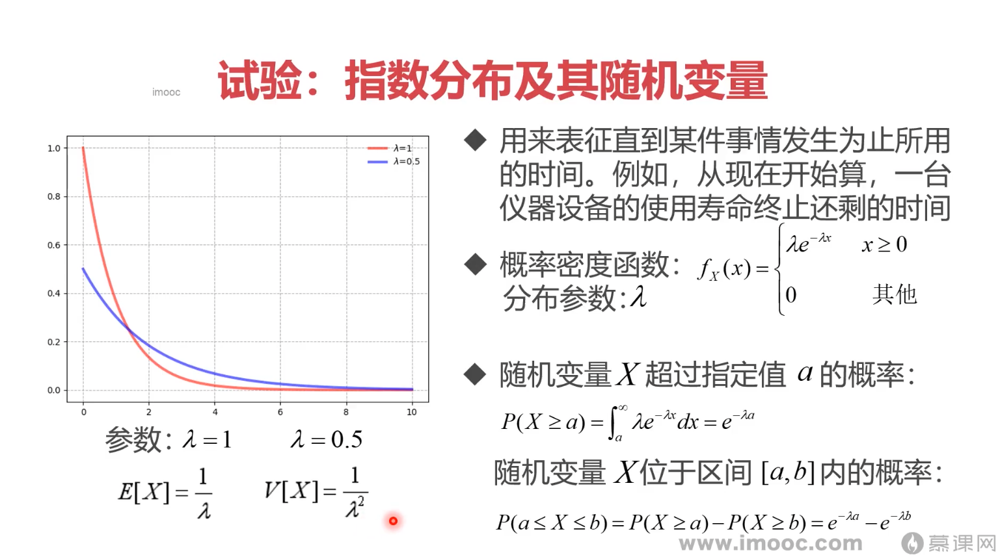

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen17.png',width=500,height=300))

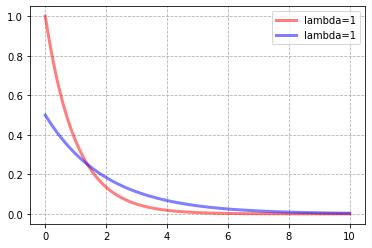

In [ ]:
from scipy.stats import expon
import matplotlib.pyplot as plt
import numpy as np

x = np.linspace(0,10,1000)
expon_rv_0 = expon() # lambda = 1,default
plt.plot(x,expon_rv_0.pdf(x),color='r',alpha=0.5,lw=3,label='lambda=1')
expon_rv_1 = expon(scale=2) # scale = 1 / lambda, lambda = 0.5
plt.plot(x,expon_rv_1.pdf(x),color='b',alpha=0.5,lw=3,label='lambda=1')
plt.legend(loc='best')
plt.grid(ls='--')
plt.show()

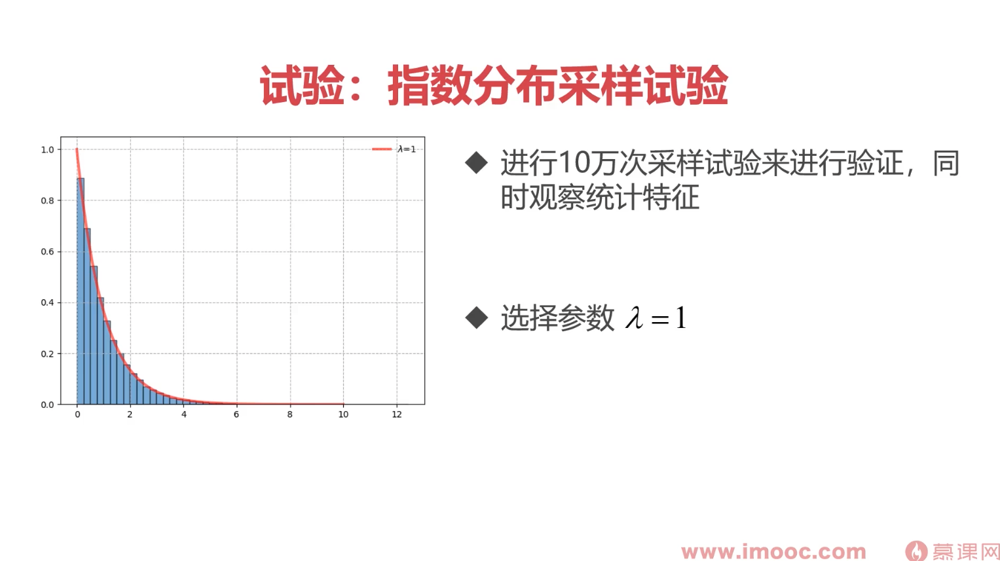

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen18.png',width=500,height=300))

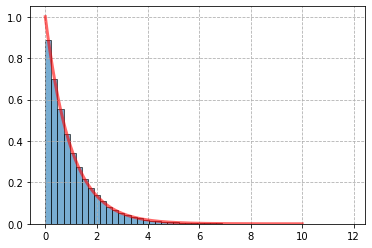

In [ ]:
from scipy.stats import expon
import matplotlib.pyplot as plt
import numpy as np

x = np.linspace(0,10,1000)
expon_rv_0 = expon() # lambda = 1,default
expon_rvs = expon_rv_0.rvs(size=100000)
plt.plot(x, expon_rv_0.pdf(x),'r',lw=3,alpha=0.6)
plt.hist(expon_rvs,density=True,bins=50,alpha=0.6,edgecolor='k')
plt.grid(ls='--')
plt.show()


### 3-10 uniform distribution

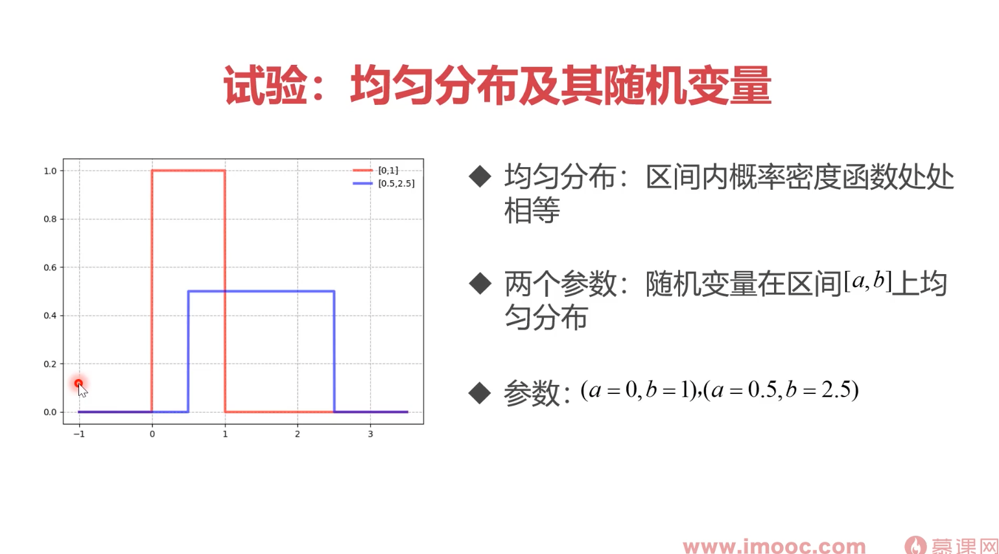

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen19.png',width=500,height=300))

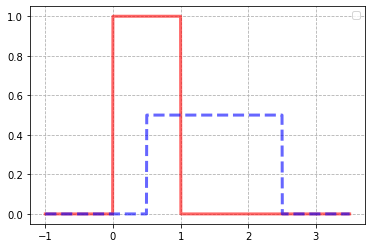

In [ ]:
from scipy.stats import uniform
import matplotlib.pyplot as plt
import numpy as np

x = np.linspace(-1,3.5,1000)
uniform_rv_0 = uniform()
uniform_rv_1 = uniform(loc=0.5,scale=2) #生成0.5到2.5之间的 uniform dist
plt.plot(x, uniform_rv_0.pdf(x),'r-',lw=3,alpha=0.6)
plt.plot(x, uniform_rv_1.pdf(x),'b--',lw=3,alpha=0.6)
plt.legend(loc='best')
plt.grid(ls='--')
plt.show()

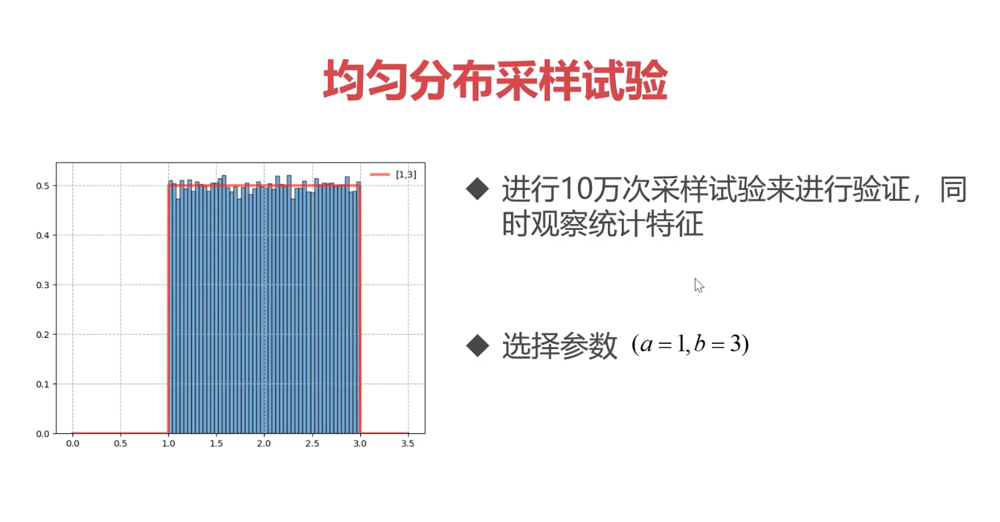

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen20.png',width=500,height=300))

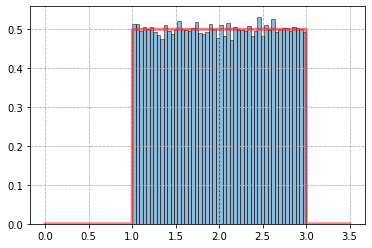

In [ ]:
from scipy.stats import uniform
import matplotlib.pyplot as plt
import numpy as np

x = np.linspace(0,3.5,1000)
uniform_rv_0 = uniform(1,2) # loc,scale
uniform_rvs = uniform_rv_0.rvs(size=100000)
plt.plot(x, uniform_rv_0.pdf(x), color='r',alpha=0.5,lw=3)
plt.hist(uniform_rvs, density=True, alpha=0.5,bins=50,edgecolor='k')
plt.grid(ls='--')
plt.show()

# Chap 4 多元随机变量

## 本章大纲

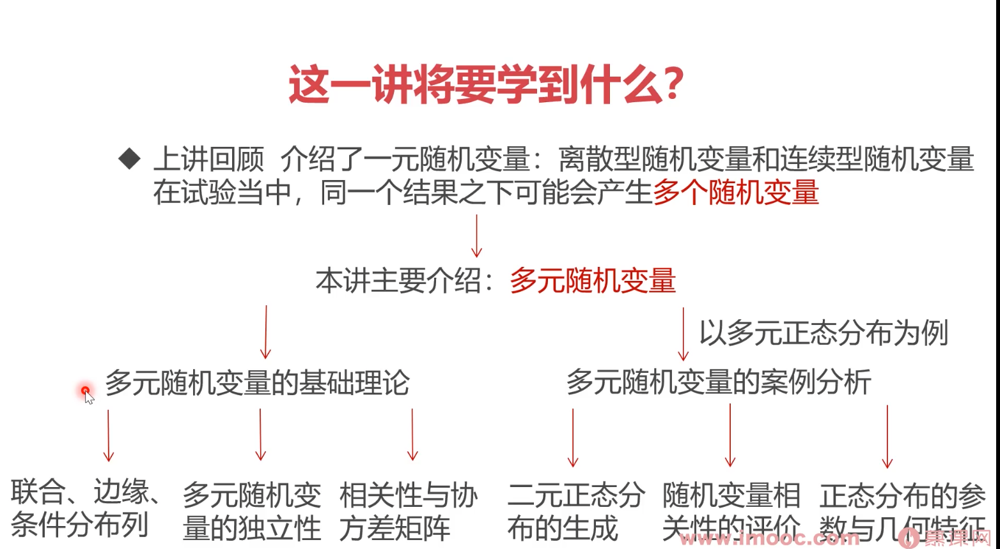

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen21.png',width=500,height=300))

## 多元随机变量基础理论

### 4-2 多元随机变量的重要分布列

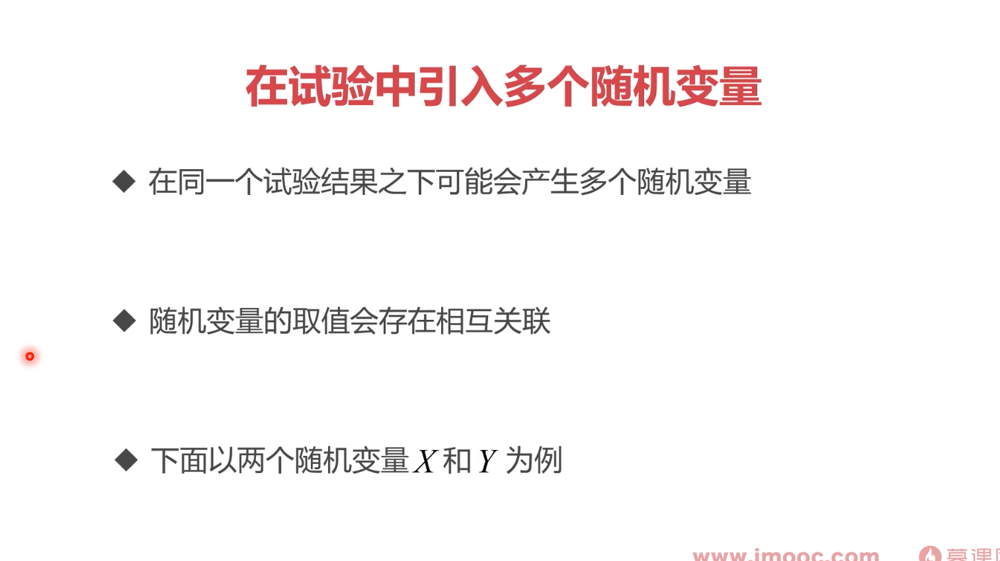

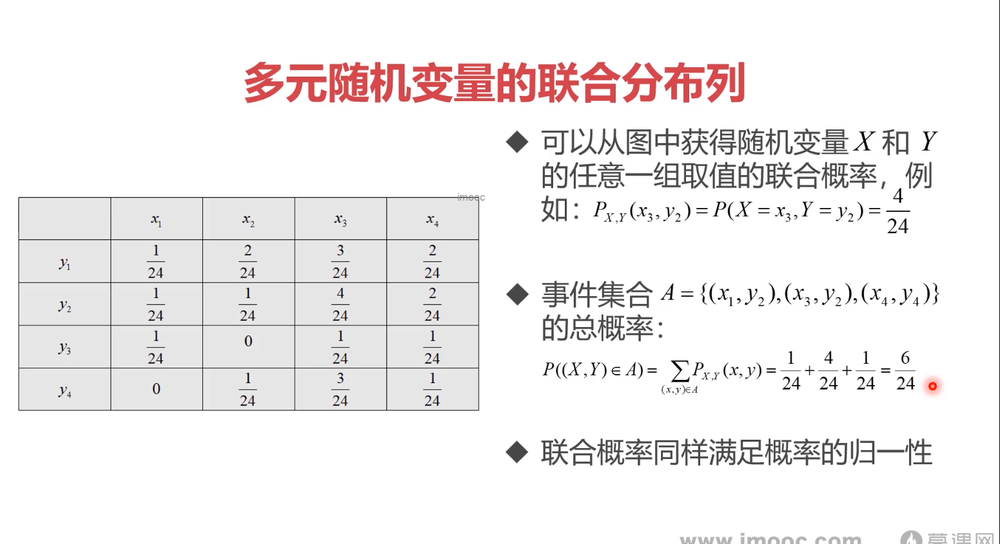

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen22.png',width=500,height=300))
display(Image('/content/drive/MyDrive/muke/screen23.png',width=500,height=300))

x的边缘分布列与y是无关的，只与自己分布列相关

边缘分布列加起来概率为1

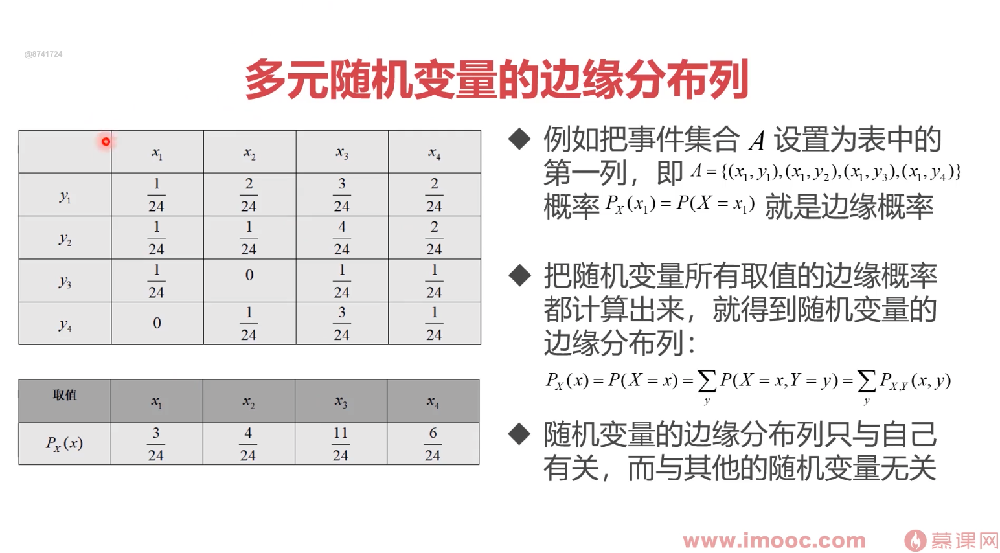

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen24.png',width=500,height=300))

条件分布列加起来概率为1

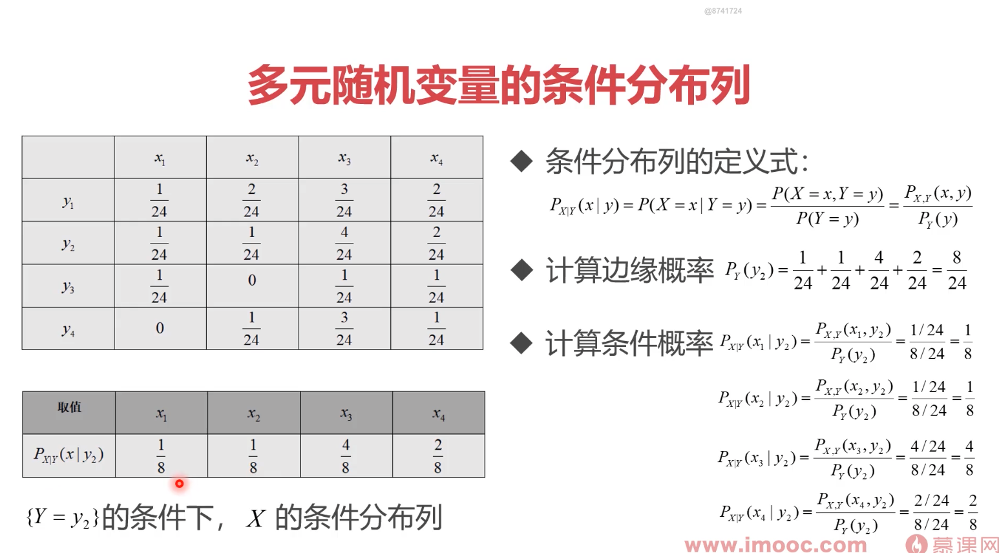

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen25.png',width=500,height=300))

### 4-3 随机变量独立性 与 事件独立性

随机变量x的条件分布列和在a情况下的无条件分布列的任意x的概率取值完全相等

随机变量x和 事件a的独立性

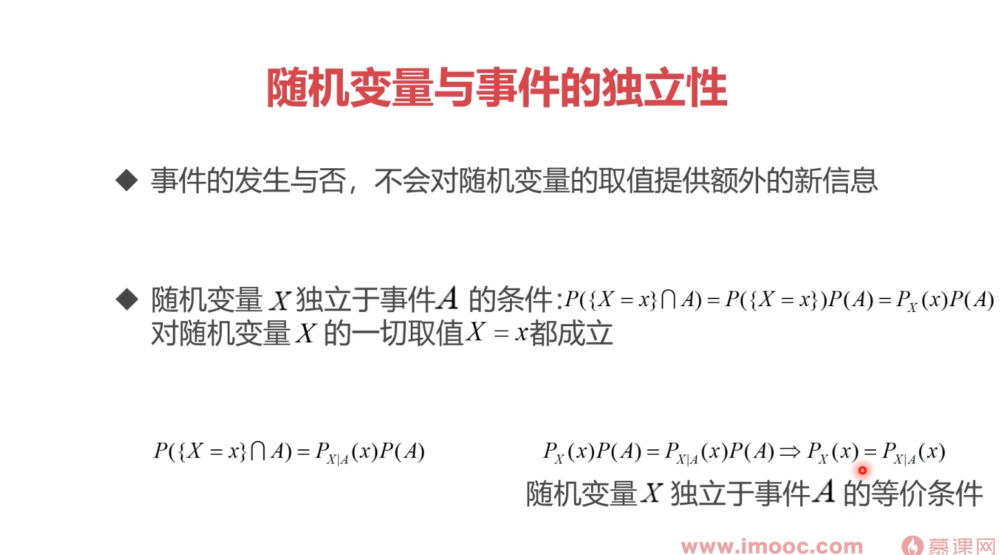

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen26.png',width=500,height=300))

a 和 b独立，但是加了一个前提条件c

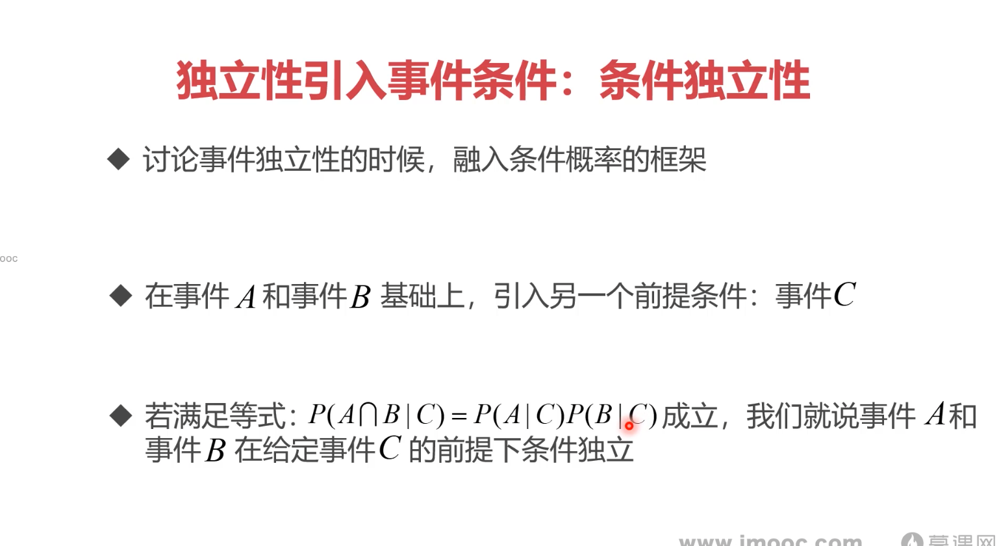

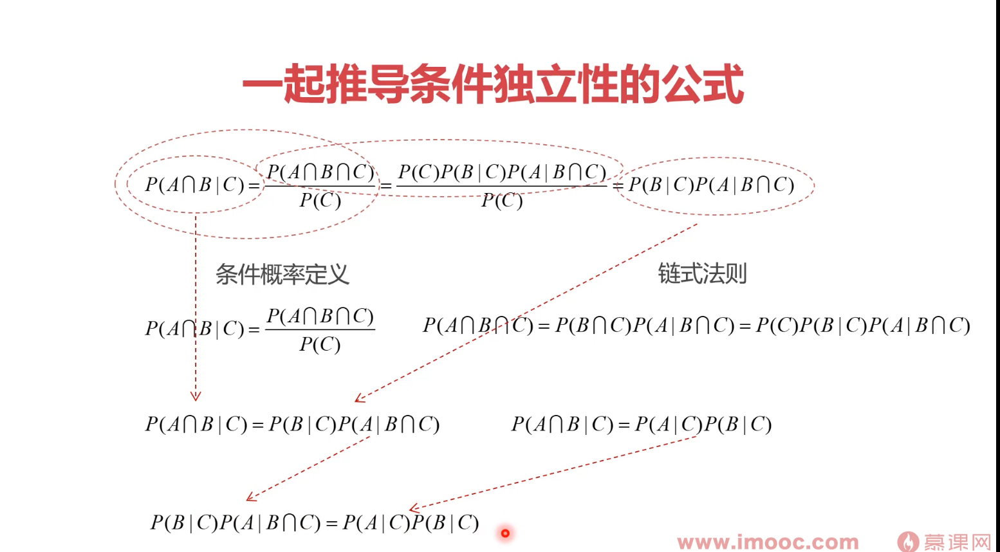

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen27.png',width=500,height=300))
display(Image('/content/drive/MyDrive/muke/screen28.png',width=500,height=300))

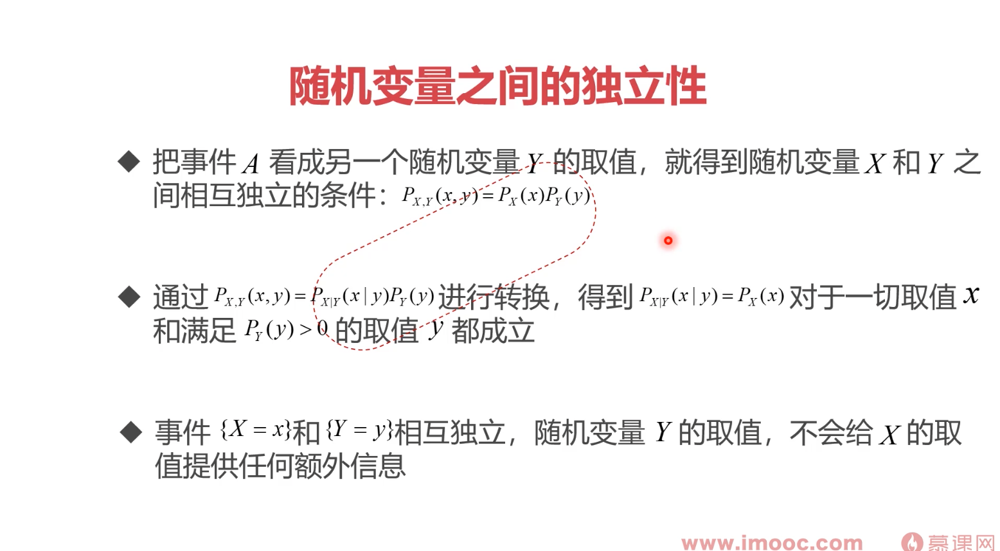

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen29.png',width=500,height=300))

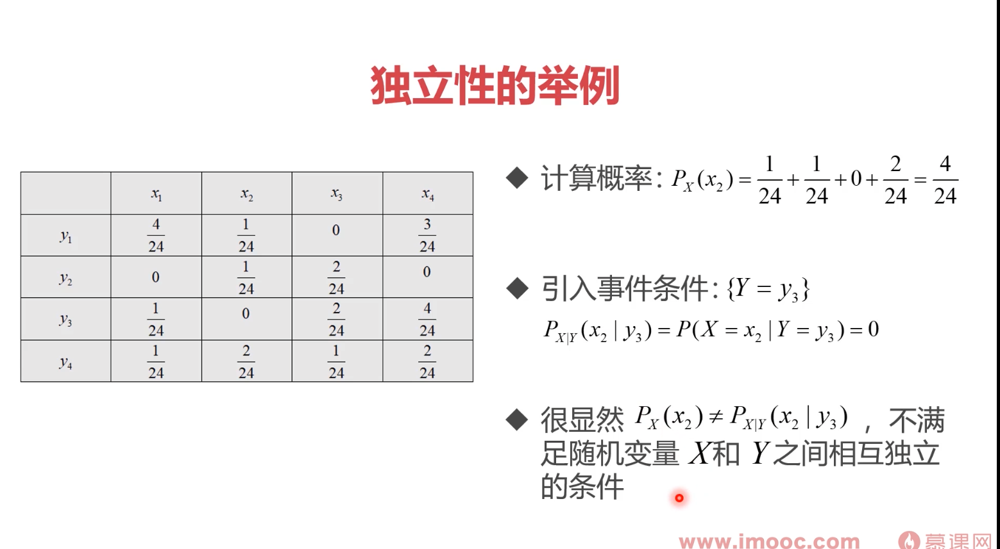

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen30.png',width=500,height=300))

下面第三行：

P(X = x | (Y=y and A) ) = P(X=x|A)

在A事件的前提条件下，不管y的数值是多少，x event的概率就等于A条件下x event的概率

以下图例子a



***条件独立 和 独立不等价：***

原本不满足相互独立的随机变量 X 和 Y，在A事件的条件下满足独立

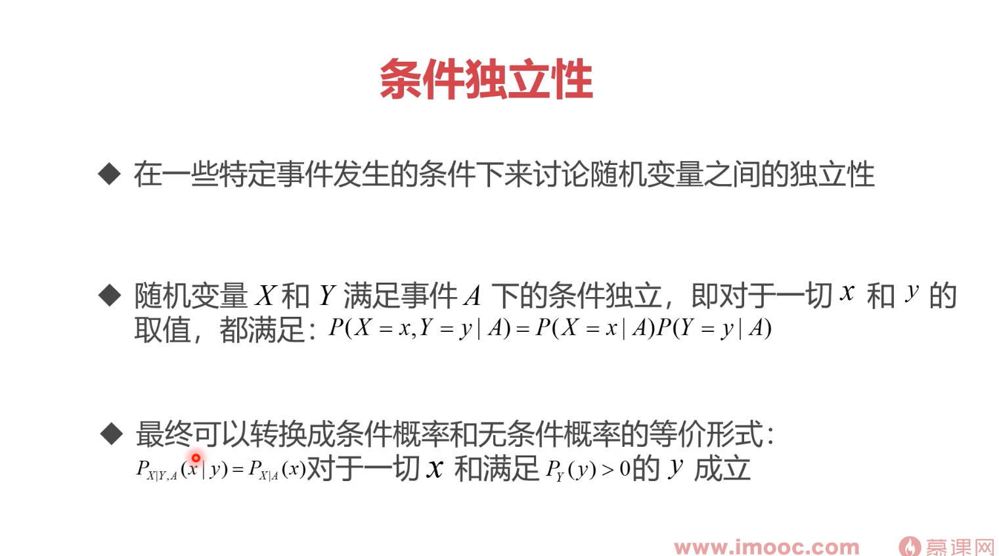

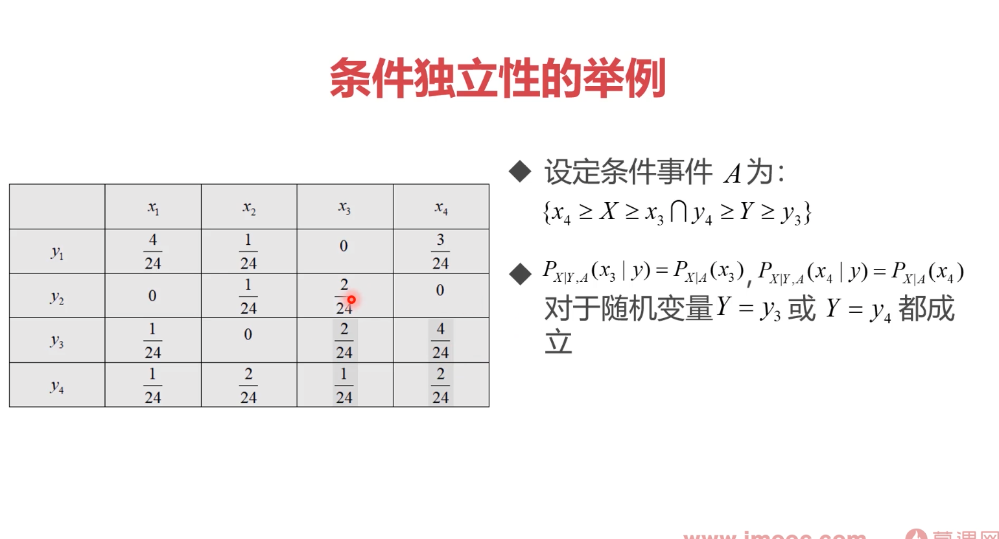

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen31.png',width=500,height=300))
display(Image('/content/drive/MyDrive/muke/screen32.png',width=500,height=300))

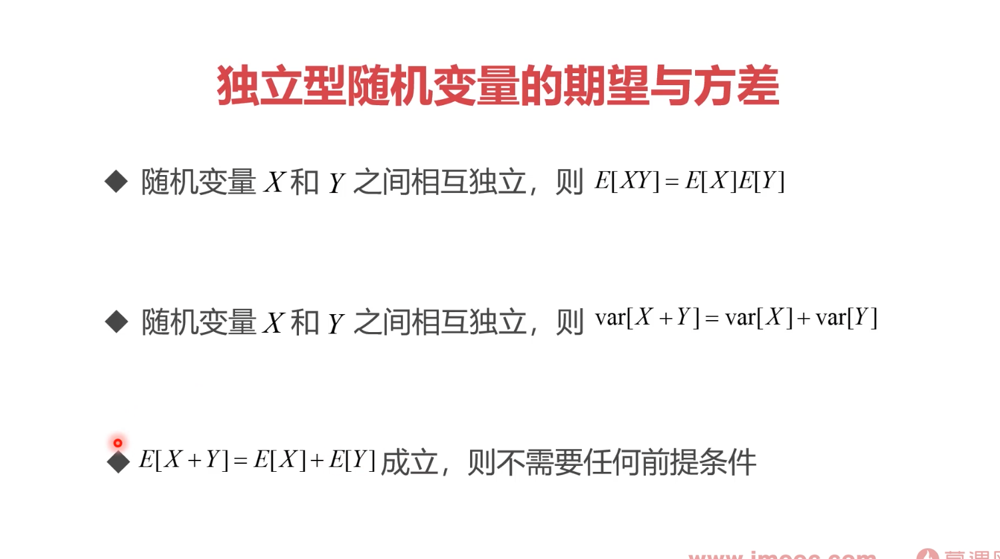

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen33.png',width=500,height=300))

### 4-4 多元随机变量的相关心与协方差矩阵

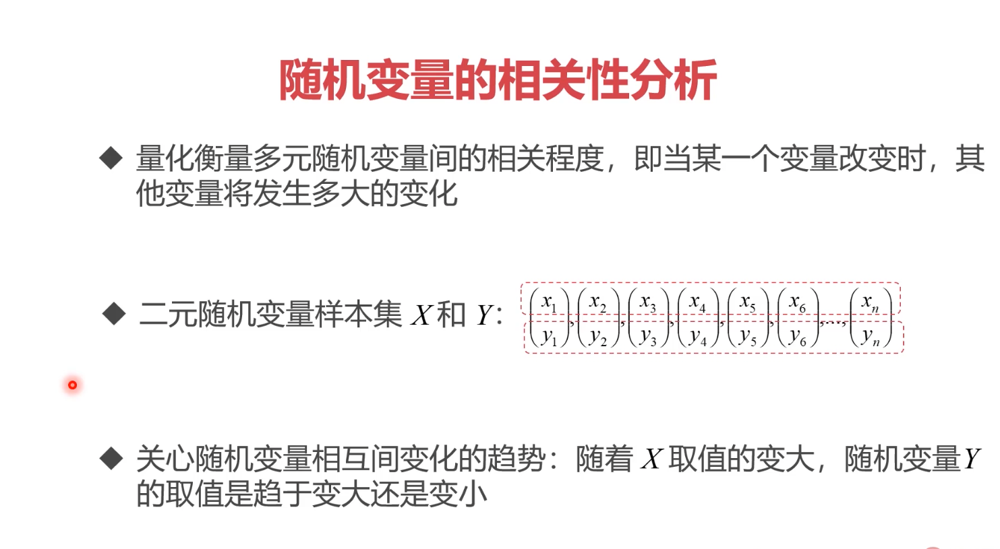

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen34.png',width=500,height=300))

协方差更准确的理解是

当其为正的时候，x点增大时，y对应增大的可能性/概率增加

协方差>0, 不是说每个点都是x增大，y增大,只要大部分点满足这个趋势即可

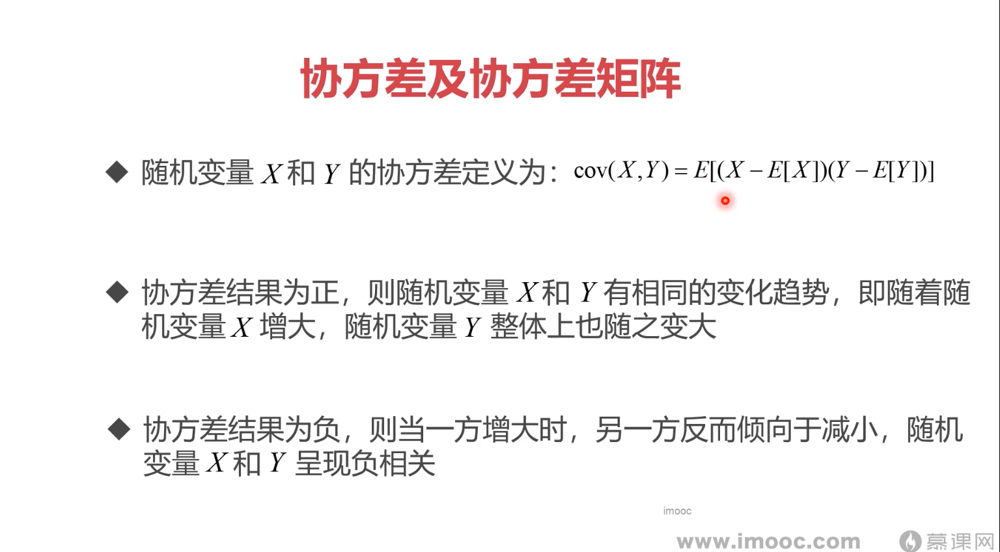

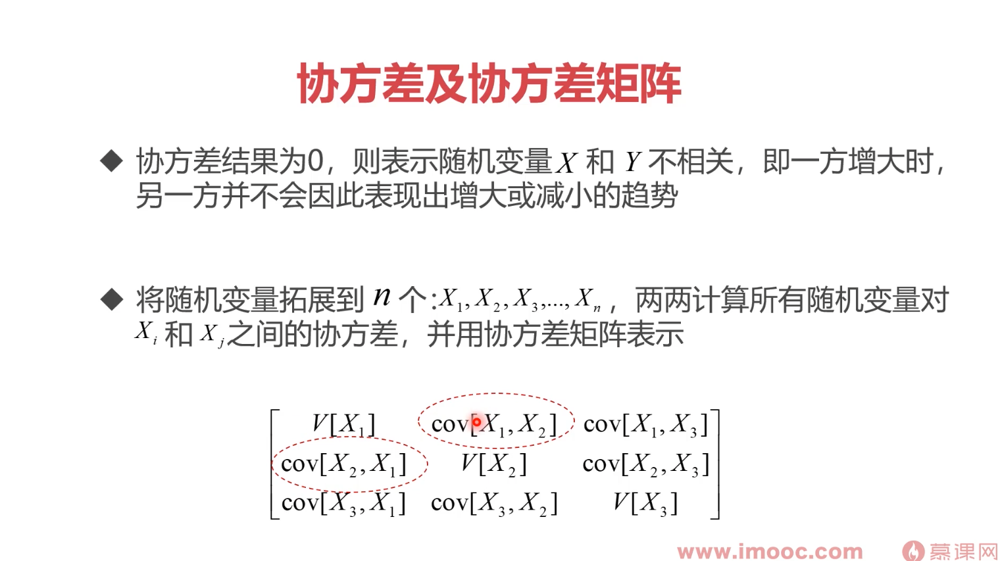

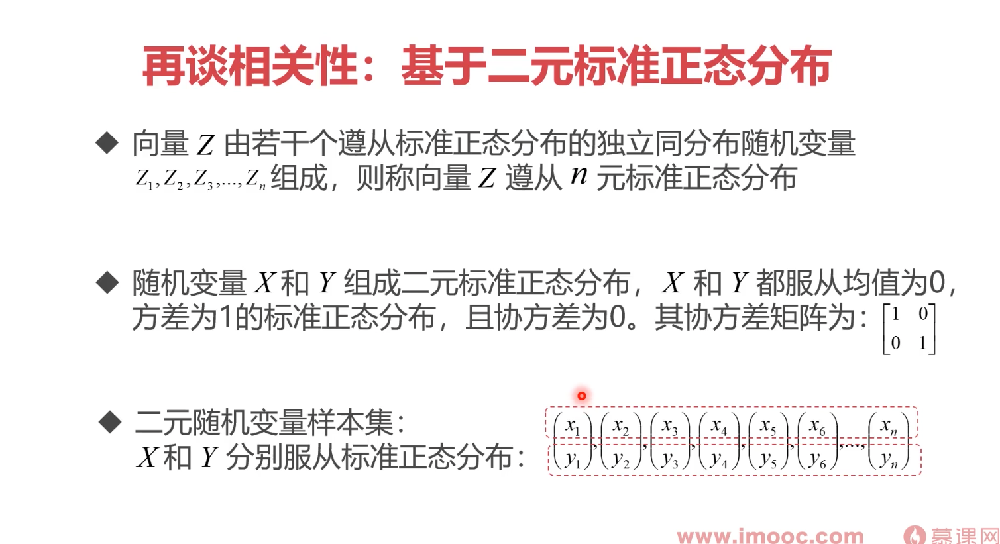

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen35.png',width=500,height=300))
display(Image('/content/drive/MyDrive/muke/screen36.png',width=500,height=300))
display(Image('/content/drive/MyDrive/muke/screen37.png',width=500,height=300))

**试验：生成二原标准正态分布**

X: mu = 0, std = var = 1

Y: mu = 0, std=var=1

协方差 = 0

生成5000组样本，并可视化

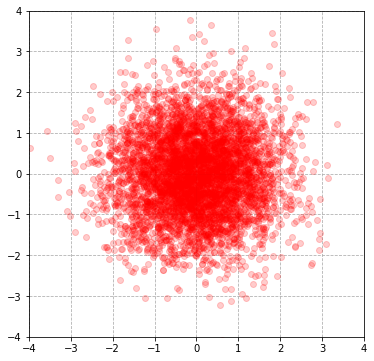

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

mean = np.array([0,0])
conv = np.array([[1,0],
                [0,1]])
x,y = np.random.multivariate_normal(mean=mean, cov=conv, size=5000).T

plt.figure(figsize=(6,6))
plt.plot(x,y,'ro',alpha=0.2)
plt.gca().axes.set_xlim(-4,4)
plt.gca().axes.set_ylim(-4,4)
plt.grid(ls='--')
plt.show()

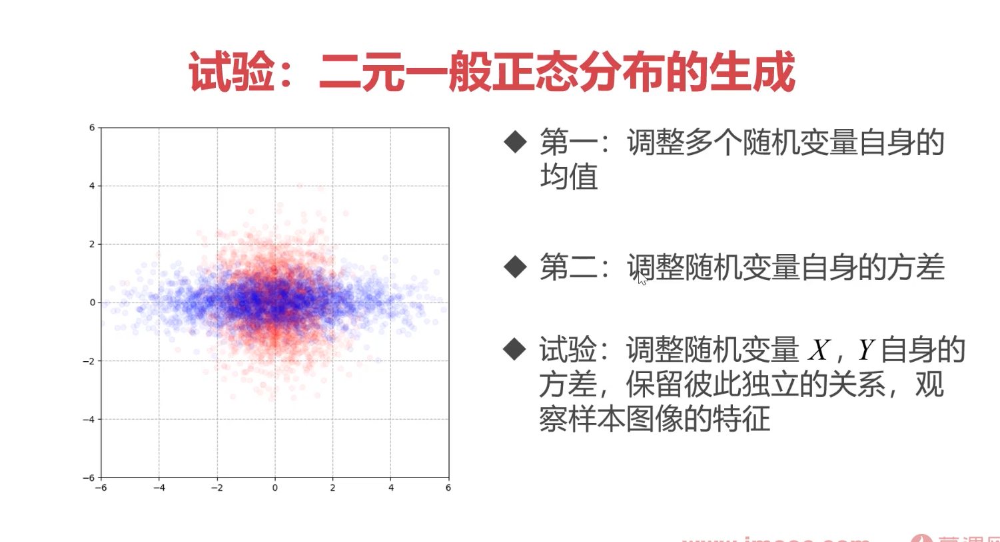

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen38.png',width=500,height=300))

设定随机变量X var = 4

var(Y) = 0.25

3000组样本

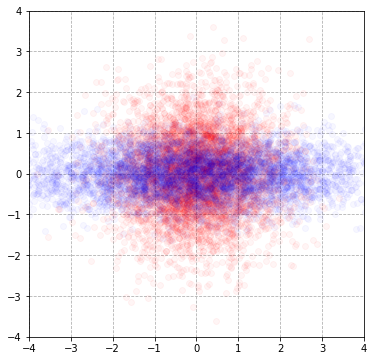

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

mean = np.array([0,0])
conv = np.array([[1,0],
                [0,1]])
x,y = np.random.multivariate_normal(mean=mean, cov=conv, size=5000).T


mean_0 = np.array([0,0])
conv_0 = np.array([[4,0],
                   [0,0.25]])
x_0,y_0 = np.random.multivariate_normal(mean=mean_0, cov=conv_0, size=5000).T

plt.figure(figsize=(6,6))
plt.plot(x,y,'ro',alpha=0.04)
plt.plot(x_0,y_0,'bo',alpha=0.03)
plt.gca().axes.set_xlim(-4,4)
plt.gca().axes.set_ylim(-4,4)
plt.grid(ls='--')
plt.show()

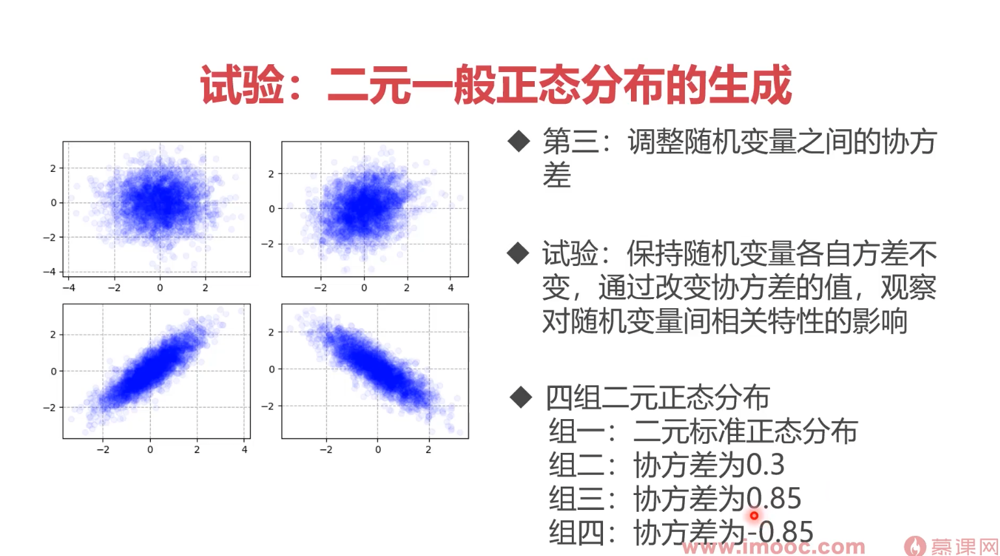

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen39.png',width=500,height=300))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: RuntimeWarning: covariance is not positive-semidefinite.


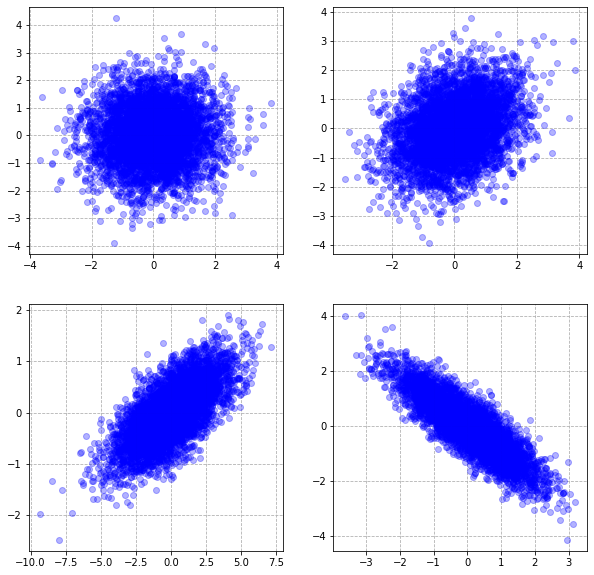

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

fig,ax = plt.subplots(2,2,figsize=(10,10))
mean=np.array([0,0])
conv_1 = np.array([[1,0],
                   [0,1]])
conv_2 = np.array([[1,0.3],
                   [0.3,1]])
conv_3 = np.array([[4,0.85],
                   [0.85,0.02]])
conv_4 = np.array([[1,-0.85],
                   [-0.85,1]])

x_1,y_1 = np.random.multivariate_normal(mean=mean, cov=conv_1, size=5000).T
x_2,y_2 = np.random.multivariate_normal(mean=mean, cov=conv_2, size=5000).T
x_3,y_3 = np.random.multivariate_normal(mean=mean, cov=conv_3, size=5000).T
x_4,y_4 = np.random.multivariate_normal(mean=mean, cov=conv_4, size=5000).T

ax[0,0].plot(x_1,y_1,'bo',alpha = 0.3)
ax[0,1].plot(x_2,y_2,'bo',alpha = 0.3)
ax[1,0].plot(x_3,y_3,'bo',alpha = 0.3)
ax[1,1].plot(x_4,y_4,'bo',alpha = 0.3)


ax[0,0].grid(ls='--')
ax[0,1].grid(ls='--')
ax[1,0].grid(ls='--')
ax[1,1].grid(ls='--')

plt.show()

之前课堂里也有计算的

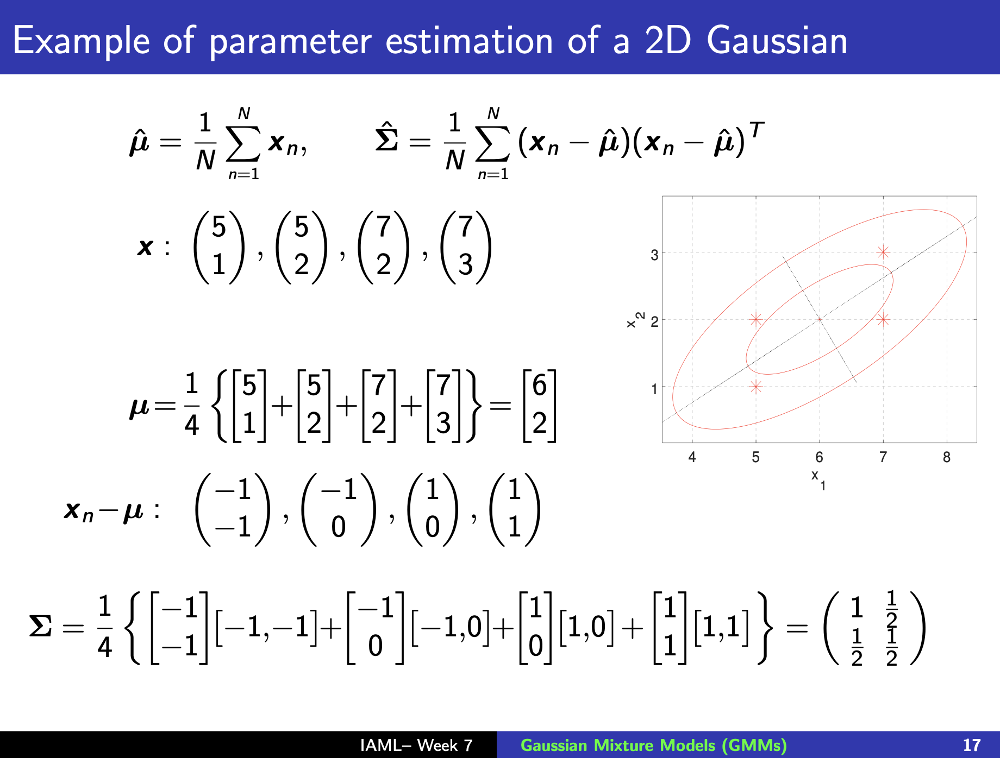

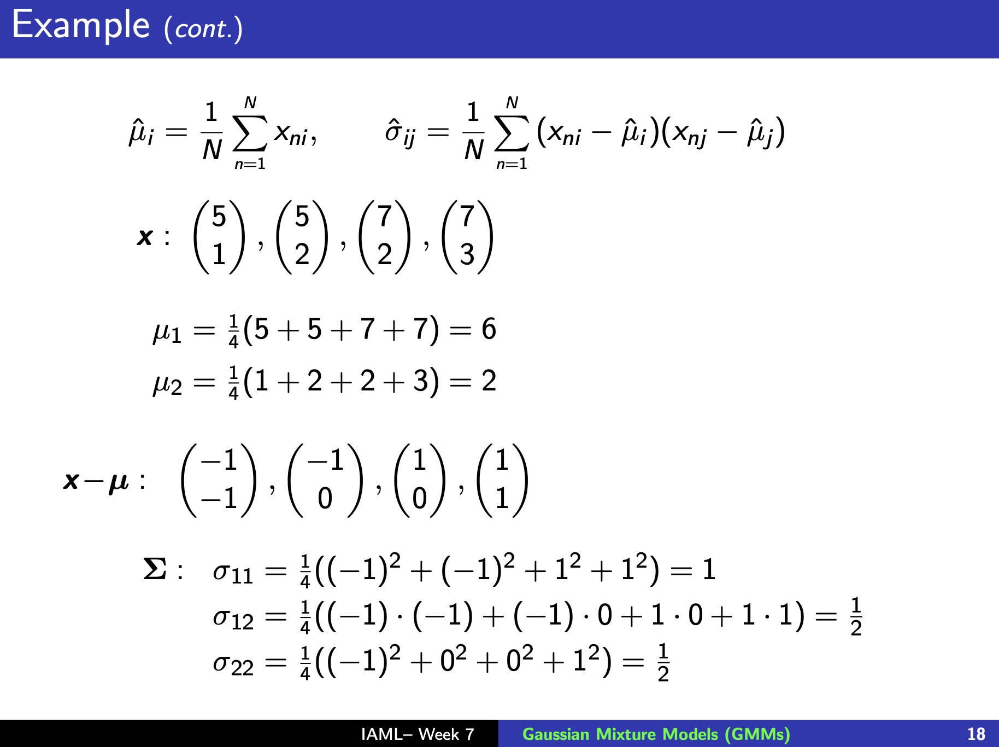

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen40.png',width=500,height=300))
display(Image('/content/drive/MyDrive/muke/screen41.png',width=500,height=300))

### 4-5 协方差 与 相关性的 一个小问题

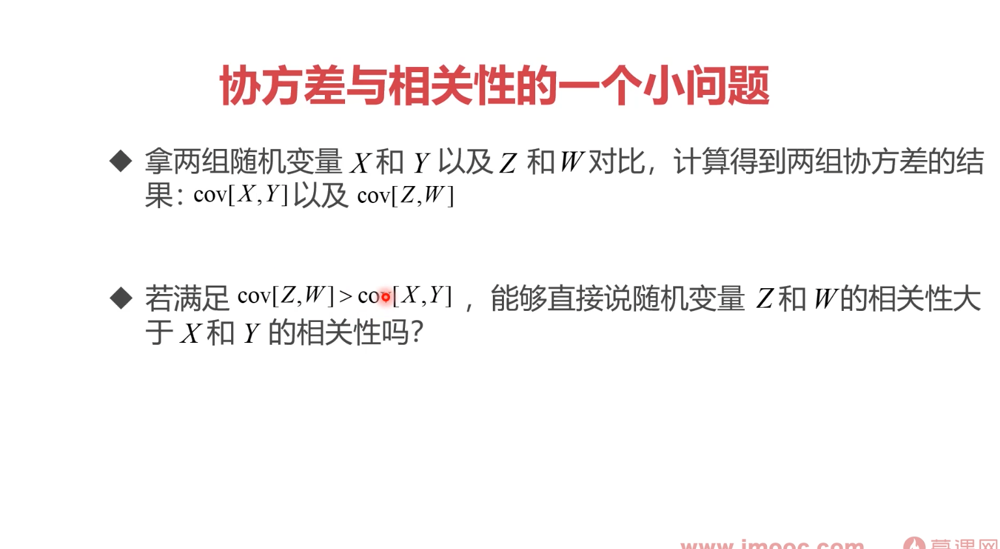

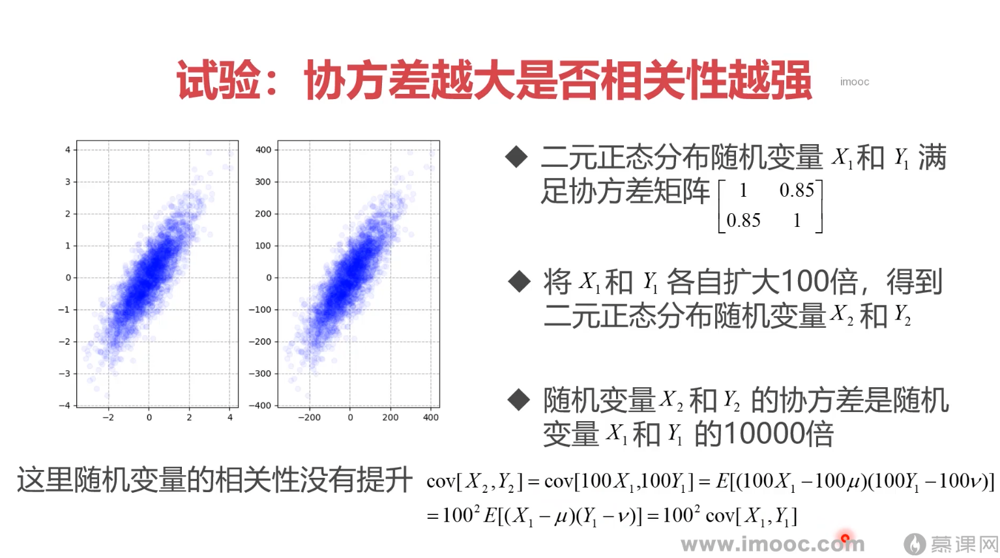

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen42.png',width=500,height=300))
display(Image('/content/drive/MyDrive/muke/screen43.png',width=500,height=300))

[[0.99462977 0.86315955]
 [0.86315955 1.0270312 ]]
[[ 9946.29773208  8631.59553529]
 [ 8631.59553529 10270.31198958]]


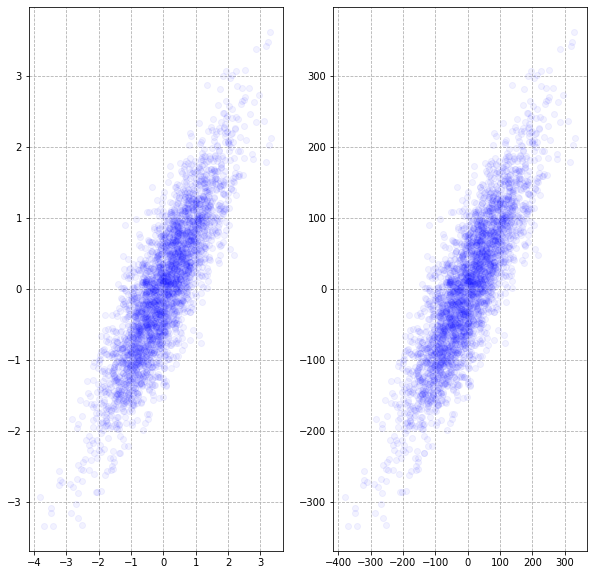

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

fig,ax = plt.subplots(1,2,figsize=(10,10))
mean=np.array([0,0])
conv_1 = np.array([[1,0.85],
                   [0.85,1]])

x_1,y_1 = np.random.multivariate_normal(mean=mean, cov=conv_1, size=3000).T
x_2 = x_1 * 100
y_2 = y_1 * 100

ax[0].plot(x_1,y_1,'bo',alpha = 0.05)
ax[1].plot(x_2,y_2,'bo',alpha = 0.05)

print(np.cov(np.vstack((x_1,y_1))))
print(np.cov(np.vstack((x_2,y_2))))
ax[0].grid(ls='--')
ax[1].grid(ls='--')
plt.show()

### 4-6 相关系数的概念和特性

### 4-6 相关系数的概念和特性

相关系数解决了4-5 中covariance的 量纲问题

从而可以将不同variable的相关性进行比较了

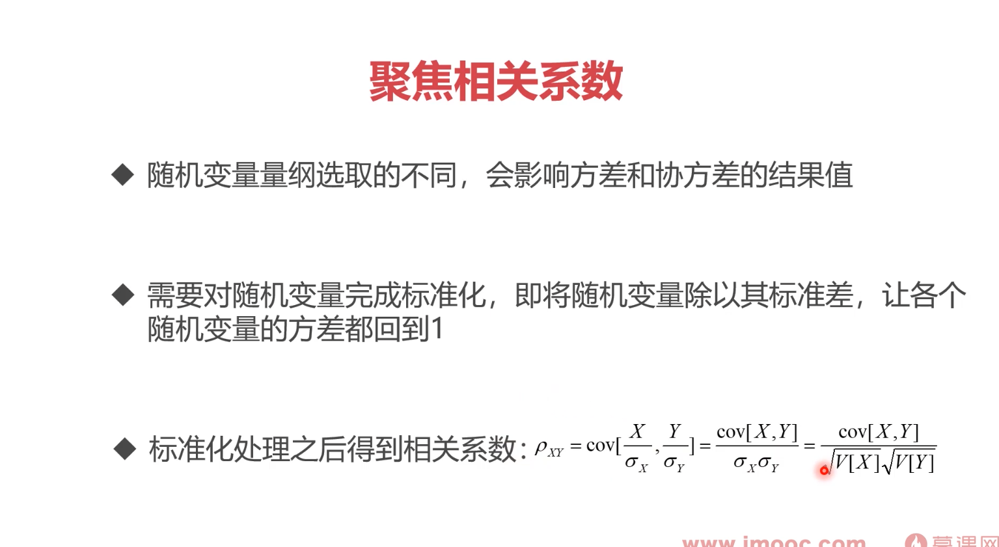

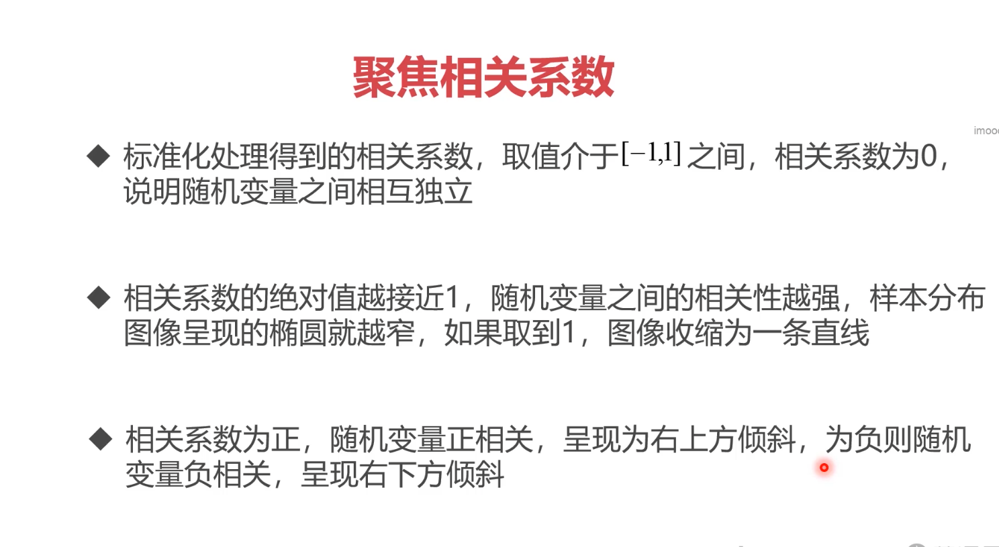

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen44.png',width=500,height=300))
display(Image('/content/drive/MyDrive/muke/screen45.png',width=500,height=300))

In [ ]:
import numpy as np

mean = np.array([0,0])
conv_1 = np.array([[1,0.85],
                   [0.85,1]])

x_1,y_1 = np.random.multivariate_normal(mean=mean, cov=conv_1, size=3000).T
x_2 = x_1 * 100
y_2 = y_1 * 100

print(np.corrcoef(np.vstack((x_1,y_1))))
print(np.corrcoef(np.vstack((x_2,y_2))))

[[1.         0.85837851]
 [0.85837851 1.        ]]
[[1.         0.85837851]
 [0.85837851 1.        ]]


### 4-7 随机变量独立与相关的概念辨析

两组随机变量独立 --》 他们肯定不相关

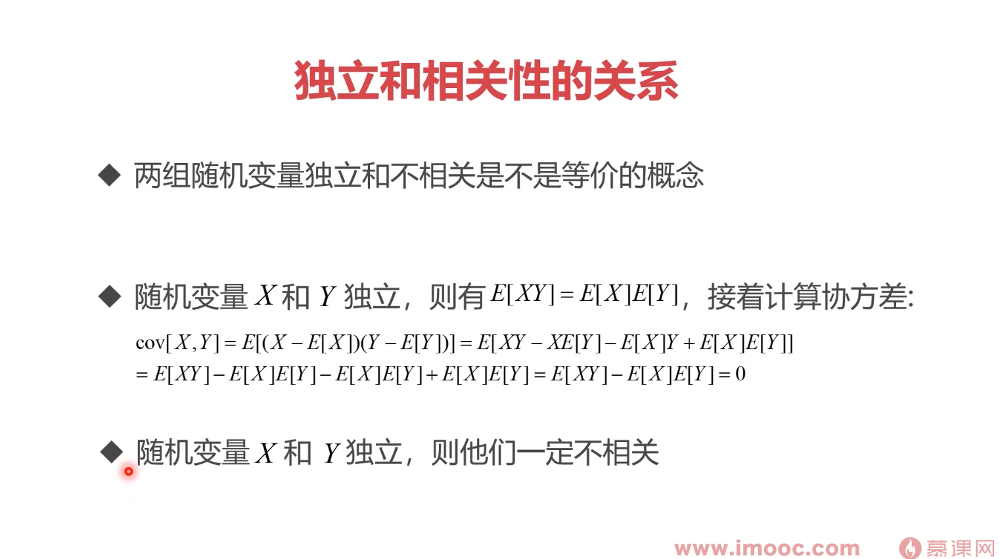

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen46.png',width=500,height=300))

那么反过来呢？不相关--》独立？

NO!! 反过来不成立的

In [ ]:
import numpy as np

X = [-2,-1,-1,0,0,1,1,2]
Y = [0,1,-1,2,-2,1,-1,0]

print(np.cov(np.vstack((X,Y)))) # X AND Y not correlated

[[1.71428571 0.        ]
 [0.         1.71428571]]


协方差是从数字表现现象进行概括的

随机变量独立性定义更触及本质

随机变量独立：X的取值不能影响Y的条件分布

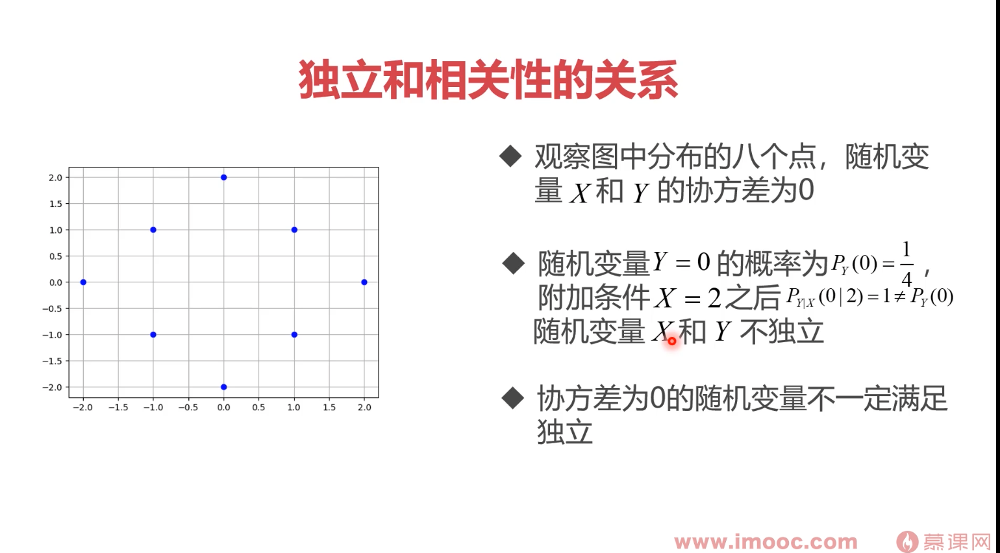

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen47.png',width=500,height=300))

### 4-8 多元高斯分布的参数特征

协方差矩阵对角线上数值都为0 --》特征两两不相关

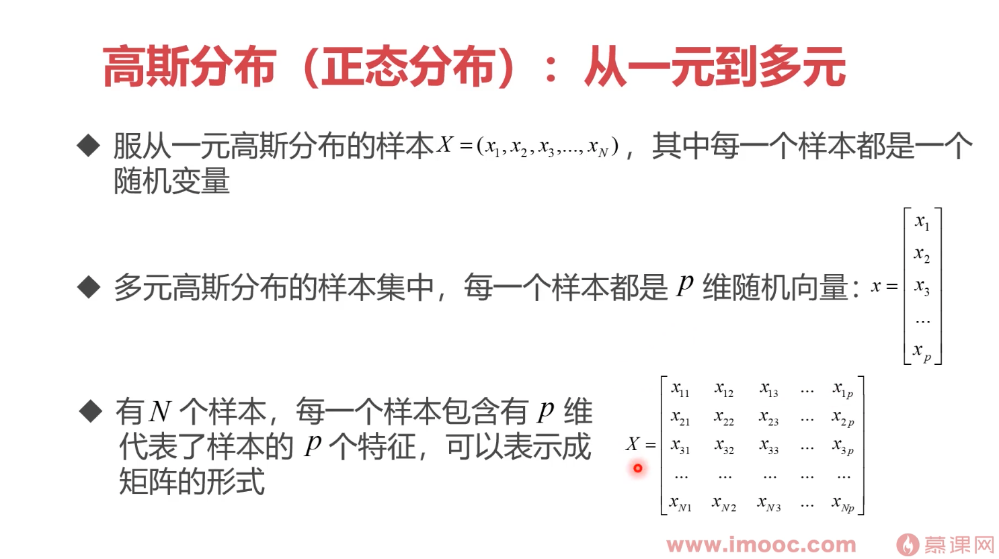

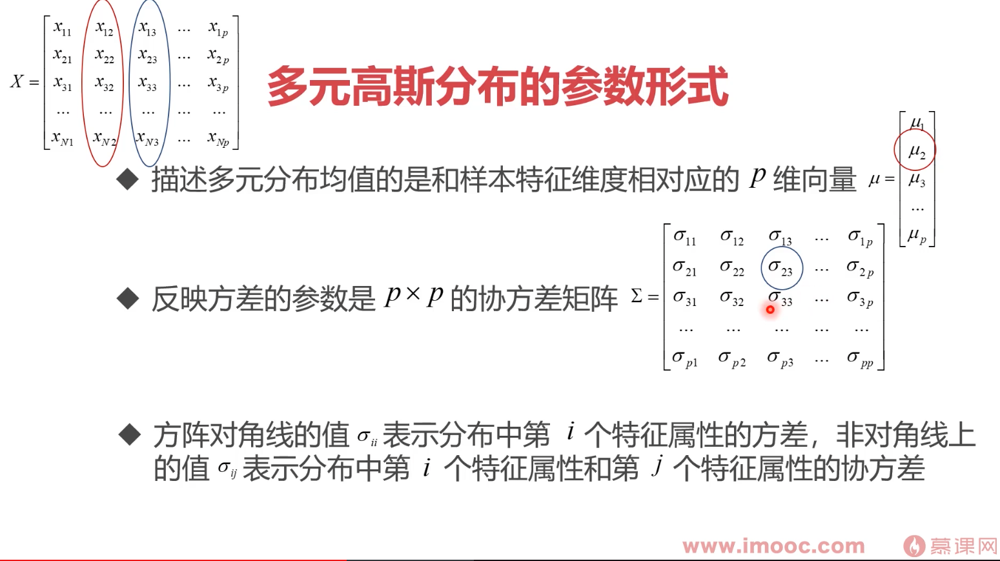

In [44]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen48.png',width=500,height=300))
display(Image('/content/drive/MyDrive/muke/screen49.png',width=500,height=300))

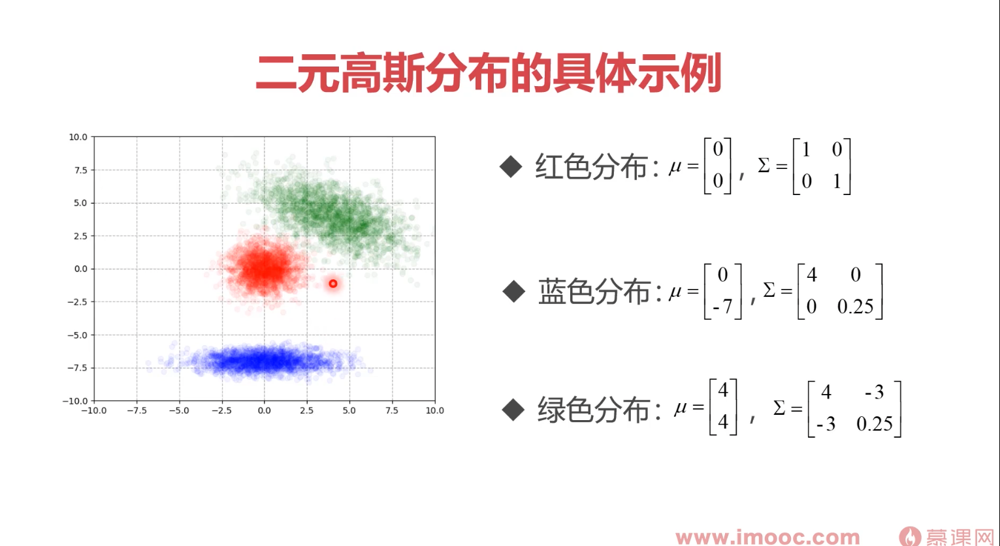

In [45]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/muke/screen50.png',width=500,height=300))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: covariance is not positive-semidefinite.


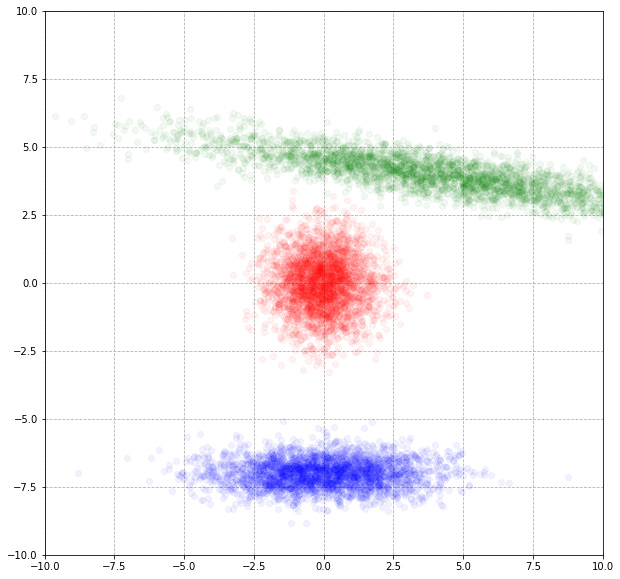

In [50]:
import numpy as np
import matplotlib.pyplot as plt

mean_1 = np.array([0,0])
conv_1 = np.array([[1,0],
                   [0,1]])

mean_2 = np.array([0,-7])
conv_2 = np.array([[4,0],
                   [0,0.25]])

mean_3 = np.array([4,4])
conv_3 = np.array([[20,-3],
                   [-3,0.25]])

x_1,y_1 = np.random.multivariate_normal(mean=mean_1, cov=conv_1, size=3000).T
x_2,y_2 = np.random.multivariate_normal(mean=mean_2, cov=conv_2, size=3000).T
x_3,y_3 = np.random.multivariate_normal(mean=mean_3, cov=conv_3, size=3000).T

plt.figure(figsize=(10,10))
plt.plot(x_1,y_1,'ro',alpha = 0.05)
plt.plot(x_2,y_2,'bo',alpha = 0.05)
plt.plot(x_3,y_3,'go',alpha = 0.05)

plt.gca().axes.set_xlim(-10,10)
plt.gca().axes.set_ylim(-10,10)
plt.grid(ls='--')
plt.show()

### 高斯分布的几何特征，其实战分析